# Face Generation
In this project, you'll use generative adversarial networks to generate new images of faces.
### Get the Data
You'll be using this dataset in this project:
- CelebA

Since the celebA dataset is complex and you're doing GANs in a project for the first time, we want you to test your neural network on MNIST before CelebA.  Running the GANs on MNIST will allow you to see how well your model trains sooner.

If you're using [FloydHub](https://www.floydhub.com/), set `data_dir` to "/input" and use the [FloydHub data ID](http://docs.floydhub.com/home/using_datasets/) "R5KrjnANiKVhLWAkpXhNBe".

In [0]:
data_dir = './data'

# FloydHub - Use with data ID "R5KrjnANiKVhLWAkpXhNBe"
#data_dir = '/input'

!mkdir ./data

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import helper

#helper.download_extract('celeba', data_dir)

mkdir: cannot create directory ‘./data’: File exists


## Explore the Data

### CelebA
The [CelebFaces Attributes Dataset (CelebA)](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) dataset contains over 200,000 celebrity images with annotations.  Since you're going to be generating faces, you won't need the annotations.  You can view the first number of examples by changing `show_n_images`.

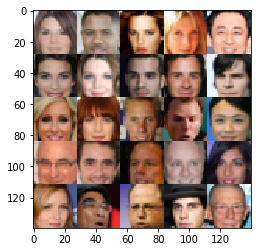

In [0]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'img_align_celeba/*.jpg'))[:show_n_images], 28, 28, 'RGB')
pyplot.imshow(helper.images_square_grid(mnist_images, 'RGB'))

## Preprocess the Data
Since the project's main focus is on building the GANs, we'll preprocess the data for you.  The values of the MNIST and CelebA dataset will be in the range of -0.5 to 0.5 of 28x28 dimensional images.  The CelebA images will be cropped to remove parts of the image that don't include a face, then resized down to 28x28.

The MNIST images are black and white images with a single [color channel](https://en.wikipedia.org/wiki/Channel_(digital_image%29) while the CelebA images have [3 color channels (RGB color channel)](https://en.wikipedia.org/wiki/Channel_(digital_image%29#RGB_Images).
## Build the Neural Network
You'll build the components necessary to build a GANs by implementing the following functions below:
- `model_inputs`
- `discriminator`
- `generator`
- `model_loss`
- `model_opt`
- `train`

### Check the Version of TensorFlow and Access to GPU
This will check to make sure you have the correct version of TensorFlow and access to a GPU

In [0]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
from distutils.version import LooseVersion
import warnings
import tensorflow as tf

# Check TensorFlow Version
assert LooseVersion(tf.__version__) >= LooseVersion('1.0'), 'Please use TensorFlow version 1.0 or newer.  You are using {}'.format(tf.__version__)
print('TensorFlow Version: {}'.format(tf.__version__))

# Check for a GPU
if not tf.test.gpu_device_name():
    warnings.warn('No GPU found. Please use a GPU to train your neural network.')
else:
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))

TensorFlow Version: 1.3.0
Default GPU Device: /gpu:0


### Input
Implement the `model_inputs` function to create TF Placeholders for the Neural Network. It should create the following placeholders:
- Real input images placeholder with rank 4 using `image_width`, `image_height`, and `image_channels`.
- Z input placeholder with rank 2 using `z_dim`.
- Learning rate placeholder with rank 0.

Return the placeholders in the following the tuple (tensor of real input images, tensor of z data)

In [0]:
import problem_unittests as tests

def model_inputs(image_width, image_height, image_channels, z_dim):
    """
    Create the model inputs
    :param image_width: The input image width
    :param image_height: The input image height
    :param image_channels: The number of image channels
    :param z_dim: The dimension of Z
    :return: Tuple of (tensor of real input images, tensor of z data, learning rate)
    """
    # TODO: Implement Function
    inputs_real = tf.placeholder(tf.float32, (None, image_width, image_height, image_channels), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    learning_rate = tf.placeholder(tf.float32)

    return inputs_real, inputs_z, learning_rate

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_inputs(model_inputs)

ERROR:tensorflow:==================================
Object was never used (type <class 'tensorflow.python.framework.ops.Operation'>):
<tf.Operation 'assert_rank_2/Assert/Assert' type=Assert>
If you want to mark it as used call its "mark_used()" method.
It was originally created here:
['File "/usr/lib/python3.5/runpy.py", line 184, in _run_module_as_main\n    "__main__", mod_spec)', 'File "/usr/lib/python3.5/runpy.py", line 85, in _run_code\n    exec(code, run_globals)', 'File "/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py", line 16, in <module>\n    app.launch_new_instance()', 'File "/usr/local/lib/python3.5/dist-packages/traitlets/config/application.py", line 658, in launch_instance\n    app.start()', 'File "/usr/local/lib/python3.5/dist-packages/ipykernel/kernelapp.py", line 477, in start\n    ioloop.IOLoop.instance().start()', 'File "/usr/local/lib/python3.5/dist-packages/zmq/eventloop/ioloop.py", line 177, in start\n    super(ZMQIOLoop, self).start()', 'File "/usr/lo

### Discriminator
Implement `discriminator` to create a discriminator neural network that discriminates on `images`.  This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "discriminator" to allow the variables to be reused.  The function should return a tuple of (tensor output of the discriminator, tensor logits of the discriminator).

In [0]:
def discriminator(images, reuse=False):
    """
    Create the discriminator network
    :param images: Tensor of input image(s)
    :param reuse: Boolean if the weights should be reused
    :return: Tuple of (tensor output of the discriminator, tensor logits of the discriminator)
    """
    # TODO: Implement Function
    alpha = tf.constant(0.2)
    
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 28x28x3
        conv_1 = tf.layers.conv2d(images, 128, 5, strides=2, padding='same',
                                  use_bias=False, activation=None)
        conv_1 = tf.maximum(alpha*conv_1,conv_1)
        # Now 14x14x128
        
        conv_2 = tf.layers.conv2d(conv_1, 256, 5, strides=2, padding='same',
                                  use_bias=False, activation=None)
        conv_2 = tf.layers.batch_normalization(conv_2, training=True)
        conv_2 = tf.maximum(alpha*conv_2,conv_2)
        # Now 7x7x256
        
        conv_3 = tf.layers.conv2d(conv_2, 512, 5, strides=1, padding='same',
                                  use_bias=False, activation=None)
        conv_3 = tf.layers.batch_normalization(conv_3, training=True)
        conv_3 = tf.maximum(alpha*conv_3,conv_3)
        # Now 7x7x512
        
        # Flatten it
        flat = tf.reshape(conv_3, (-1, 4*4*512))
        logits = tf.layers.dense(flat, 1)

        out = tf.sigmoid(logits)
    
    return out, logits

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_discriminator(discriminator, tf)

Tests Passed


### Generator
Implement `generator` to generate an image using `z`. This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "generator" to allow the variables to be reused. The function should return the generated 28 x 28 x `out_channel_dim` images.

In [0]:
def generator(z, out_channel_dim, is_train=True):
    """
    Create the generator network
    :param z: Input z
    :param out_channel_dim: The number of channels in the output image
    :param is_train: Boolean if generator is being used for training
    :return: The tensor output of the generator
    """
    # TODO: Implement Function

    alpha = tf.constant(0.2)
    
    with tf.variable_scope('generator', reuse=not is_train):
        # First fully connected layer
        x = tf.layers.dense(z, 7*7*1024)
        fc = tf.reshape(x,[-1,7,7,1024])
        fc = tf.layers.batch_normalization(fc, training=is_train)
        fc = tf.maximum(alpha*fc,fc)
        
        convt_1 = tf.layers.conv2d_transpose(fc, 512, 5, strides=2, padding='same',
                                             use_bias=False, activation=None)
        convt_1 = tf.layers.batch_normalization(convt_1, training=is_train)
        convt_1 = tf.maximum(alpha*convt_1,convt_1)
        # 14x14x512
        
        convt_2 = tf.layers.conv2d_transpose(convt_1, 256, 5, strides=2, padding='same',
                                             use_bias=False, activation=None)
        convt_2 = tf.layers.batch_normalization(convt_2, training=is_train)
        convt_2 = tf.maximum(alpha*convt_2,convt_2)
        # 28x28x256

        convt_3 = tf.layers.conv2d_transpose(convt_2, out_channel_dim, 5, strides=1,
                                             padding='same', use_bias=False, activation=None)

        # Output layer, 28 x 28 x out_channel_dim
        logits = convt_3
        
        out = tf.tanh(logits)    

    return out

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_generator(generator, tf)

Tests Passed


### Loss
Implement `model_loss` to build the GANs for training and calculate the loss.  The function should return a tuple of (discriminator loss, generator loss).  Use the following functions you implemented:
- `discriminator(images, reuse=False)`
- `generator(z, out_channel_dim, is_train=True)`

In [0]:
def model_loss(input_real, input_z, out_channel_dim):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    # TODO: Implement Function
    g_out = generator(input_z, out_channel_dim)
    d_out_real, d_logits_real = discriminator(input_real)
    d_out_fake, d_logits_fake = discriminator(g_out, reuse=True)

    # Label smoothing
    smooth = 0.1
    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, 
                                                labels=(1-smooth)*tf.ones_like(d_out_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_out_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_out_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_loss(model_loss)

Tests Passed


### Optimization
Implement `model_opt` to create the optimization operations for the GANs. Use [`tf.trainable_variables`](https://www.tensorflow.org/api_docs/python/tf/trainable_variables) to get all the trainable variables.  Filter the variables with names that are in the discriminator and generator scope names.  The function should return a tuple of (discriminator training operation, generator training operation).

In [0]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # TODO: Implement Function
    
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_opt(model_opt, tf)

Tests Passed


## Neural Network Training
### Show Output
Use this function to show the current output of the generator during training. It will help you determine how well the GANs is training.

In [0]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import numpy as np

def show_generator_output(sess, n_images, input_z, out_channel_dim, image_mode):
    """
    Show example output for the generator
    :param sess: TensorFlow session
    :param n_images: Number of Images to display
    :param input_z: Input Z Tensor
    :param out_channel_dim: The number of channels in the output image
    :param image_mode: The mode to use for images ("RGB" or "L")
    """
    cmap = None if image_mode == 'RGB' else 'gray'
    z_dim = input_z.get_shape().as_list()[-1]
    example_z = np.random.uniform(-1, 1, size=[n_images, z_dim])

    samples = sess.run(
        generator(input_z, out_channel_dim, False),
        feed_dict={input_z: example_z})

    images_grid = helper.images_square_grid(samples, image_mode)
    pyplot.imshow(images_grid, cmap=cmap)
    pyplot.show()

### Train
Implement `train` to build and train the GANs.  Use the following functions you implemented:
- `model_inputs(image_width, image_height, image_channels, z_dim)`
- `model_loss(input_real, input_z, out_channel_dim)`
- `model_opt(d_loss, g_loss, learning_rate, beta1)`

Use the `show_generator_output` to show `generator` output while you train. Running `show_generator_output` for every batch will drastically increase training time and increase the size of the notebook.  It's recommended to print the `generator` output every 100 batches.

In [0]:
def train(epoch_count, batch_size, z_dim, learning_rate, beta1, get_batches, data_shape, data_image_mode):
    """
    Train the GAN
    :param epoch_count: Number of epochs
    :param batch_size: Batch Size
    :param z_dim: Z dimension
    :param learning_rate: Learning Rate
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :param get_batches: Function to get batches
    :param data_shape: Shape of the data
    :param data_image_mode: The image mode to use for images ("RGB" or "L")
    """
    
    input_real, input_z, lr = model_inputs(data_shape[1], data_shape[2], data_shape[3], z_dim)
    d_loss, g_loss          = model_loss(input_real, input_z, data_shape[3])
    d_opt, g_opt            = model_opt(d_loss, g_loss, lr, beta1)
        
    saver = tf.train.Saver()

    steps = 0
    
    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for epoch_i in range(epoch_count):
            for batch_images in get_batches(batch_size):
                # TODO: Train Model
                
                steps += 1
                
                # Rescale real images from [-0.5,0.5] to [-1.0,1.0]
                batch_images *= 2

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_dim))

                # Run optimizers
                _ = sess.run(d_opt, feed_dict={input_real: batch_images, input_z: batch_z, lr : learning_rate})
                _ = sess.run(g_opt, feed_dict={input_real: batch_images, input_z: batch_z, lr : learning_rate})

                if steps % 10 == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = d_loss.eval({input_z: batch_z, input_real: batch_images, lr : learning_rate})
                    train_loss_g = g_loss.eval({input_z: batch_z, lr : learning_rate})

                    print("Epoch {}/{}...".format(epoch_i+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))

                if steps % 100 == 0:
                    show_generator_output(sess, 64, input_z, data_shape[3], data_image_mode)

        saver.save(sess, './checkpoints/generator.ckpt')

### CelebA
Run your GANs on CelebA.  It will take around 20 minutes on the average GPU to run one epoch.  You can run the whole epoch or stop when it starts to generate realistic faces.

Epoch 1/1... Discriminator Loss: 1.1982... Generator Loss: 0.6389
Epoch 1/1... Discriminator Loss: 1.1292... Generator Loss: 0.6158
Epoch 1/1... Discriminator Loss: 0.9169... Generator Loss: 0.7866
Epoch 1/1... Discriminator Loss: 0.6053... Generator Loss: 1.1666
Epoch 1/1... Discriminator Loss: 0.9384... Generator Loss: 0.6864
Epoch 1/1... Discriminator Loss: 0.6499... Generator Loss: 1.1822
Epoch 1/1... Discriminator Loss: 0.3657... Generator Loss: 1.6958
Epoch 1/1... Discriminator Loss: 0.3337... Generator Loss: 1.9086
Epoch 1/1... Discriminator Loss: 0.8092... Generator Loss: 1.1098
Epoch 1/1... Discriminator Loss: 0.9666... Generator Loss: 0.6338


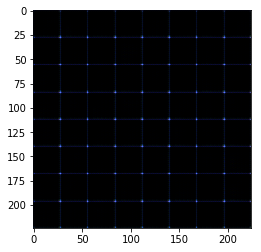

Epoch 1/1... Discriminator Loss: 0.5806... Generator Loss: 1.3111
Epoch 1/1... Discriminator Loss: 0.9130... Generator Loss: 0.9063
Epoch 1/1... Discriminator Loss: 0.7059... Generator Loss: 1.3073
Epoch 1/1... Discriminator Loss: 0.5079... Generator Loss: 1.4534
Epoch 1/1... Discriminator Loss: 0.3374... Generator Loss: 1.7087
Epoch 1/1... Discriminator Loss: 0.3077... Generator Loss: 1.8554
Epoch 1/1... Discriminator Loss: 0.3835... Generator Loss: 1.4766
Epoch 1/1... Discriminator Loss: 0.4519... Generator Loss: 1.4160
Epoch 1/1... Discriminator Loss: 0.3171... Generator Loss: 1.6592
Epoch 1/1... Discriminator Loss: 0.2062... Generator Loss: 2.2070


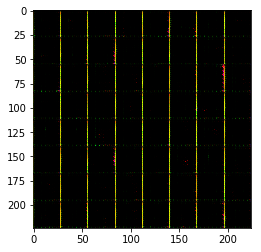

Epoch 1/1... Discriminator Loss: 0.2308... Generator Loss: 2.1062
Epoch 1/1... Discriminator Loss: 0.1850... Generator Loss: 2.2812
Epoch 1/1... Discriminator Loss: 0.2222... Generator Loss: 2.1778
Epoch 1/1... Discriminator Loss: 0.5211... Generator Loss: 2.0600
Epoch 1/1... Discriminator Loss: 1.8164... Generator Loss: 0.4215
Epoch 1/1... Discriminator Loss: 0.9327... Generator Loss: 1.5916
Epoch 1/1... Discriminator Loss: 0.9978... Generator Loss: 0.8647
Epoch 1/1... Discriminator Loss: 1.0408... Generator Loss: 1.5291
Epoch 1/1... Discriminator Loss: 1.5354... Generator Loss: 0.8557
Epoch 1/1... Discriminator Loss: 1.4231... Generator Loss: 0.5323


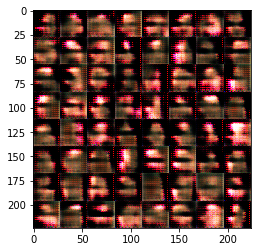

Epoch 1/1... Discriminator Loss: 0.7272... Generator Loss: 1.4800
Epoch 1/1... Discriminator Loss: 1.2978... Generator Loss: 0.4677
Epoch 1/1... Discriminator Loss: 0.8647... Generator Loss: 0.9468
Epoch 1/1... Discriminator Loss: 1.0936... Generator Loss: 0.8574
Epoch 1/1... Discriminator Loss: 1.5037... Generator Loss: 1.0057
Epoch 1/1... Discriminator Loss: 1.0718... Generator Loss: 0.8497
Epoch 1/1... Discriminator Loss: 0.8909... Generator Loss: 0.9345
Epoch 1/1... Discriminator Loss: 1.1795... Generator Loss: 0.7028
Epoch 1/1... Discriminator Loss: 1.0431... Generator Loss: 0.6976
Epoch 1/1... Discriminator Loss: 0.9514... Generator Loss: 1.1631


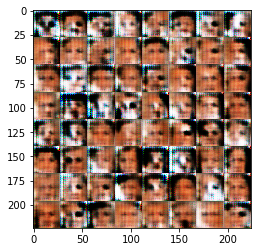

Epoch 1/1... Discriminator Loss: 1.2996... Generator Loss: 0.8444
Epoch 1/1... Discriminator Loss: 1.5343... Generator Loss: 0.5093
Epoch 1/1... Discriminator Loss: 1.2167... Generator Loss: 0.8177
Epoch 1/1... Discriminator Loss: 1.0110... Generator Loss: 0.9125
Epoch 1/1... Discriminator Loss: 0.9141... Generator Loss: 1.1129
Epoch 1/1... Discriminator Loss: 1.4325... Generator Loss: 0.8033
Epoch 1/1... Discriminator Loss: 1.2757... Generator Loss: 0.7405
Epoch 1/1... Discriminator Loss: 1.1466... Generator Loss: 0.7637
Epoch 1/1... Discriminator Loss: 1.0038... Generator Loss: 0.9910
Epoch 1/1... Discriminator Loss: 1.1784... Generator Loss: 0.8271


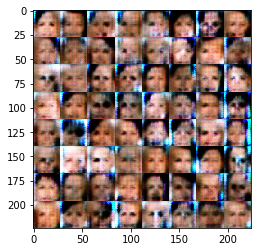

Epoch 1/1... Discriminator Loss: 1.1400... Generator Loss: 0.9201
Epoch 1/1... Discriminator Loss: 0.9590... Generator Loss: 0.9765
Epoch 1/1... Discriminator Loss: 1.0556... Generator Loss: 0.6880
Epoch 1/1... Discriminator Loss: 1.3404... Generator Loss: 0.6245
Epoch 1/1... Discriminator Loss: 0.8998... Generator Loss: 0.9336
Epoch 1/1... Discriminator Loss: 1.0932... Generator Loss: 1.7947
Epoch 1/1... Discriminator Loss: 1.2190... Generator Loss: 0.7347
Epoch 1/1... Discriminator Loss: 1.2751... Generator Loss: 0.5403
Epoch 1/1... Discriminator Loss: 0.8232... Generator Loss: 1.0793
Epoch 1/1... Discriminator Loss: 1.1270... Generator Loss: 0.6954


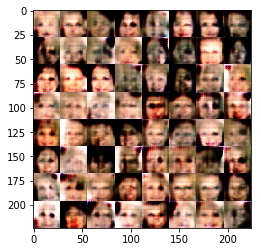

Epoch 1/1... Discriminator Loss: 1.3177... Generator Loss: 0.4503
Epoch 1/1... Discriminator Loss: 0.9438... Generator Loss: 0.9515
Epoch 1/1... Discriminator Loss: 1.1220... Generator Loss: 0.7008
Epoch 1/1... Discriminator Loss: 1.2363... Generator Loss: 0.6032
Epoch 1/1... Discriminator Loss: 0.9794... Generator Loss: 0.9087
Epoch 1/1... Discriminator Loss: 1.1956... Generator Loss: 2.4922
Epoch 1/1... Discriminator Loss: 1.1737... Generator Loss: 0.5978
Epoch 1/1... Discriminator Loss: 1.0793... Generator Loss: 0.8893
Epoch 1/1... Discriminator Loss: 1.0010... Generator Loss: 1.4592
Epoch 1/1... Discriminator Loss: 0.9640... Generator Loss: 1.2760


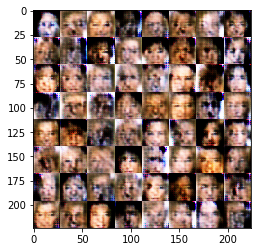

Epoch 1/1... Discriminator Loss: 1.0148... Generator Loss: 0.9961
Epoch 1/1... Discriminator Loss: 1.2382... Generator Loss: 0.8275
Epoch 1/1... Discriminator Loss: 1.0099... Generator Loss: 1.2117
Epoch 1/1... Discriminator Loss: 0.9448... Generator Loss: 0.7033
Epoch 1/1... Discriminator Loss: 1.1211... Generator Loss: 0.8966
Epoch 1/1... Discriminator Loss: 0.9936... Generator Loss: 0.7583
Epoch 1/1... Discriminator Loss: 0.7748... Generator Loss: 0.9230
Epoch 1/1... Discriminator Loss: 1.2740... Generator Loss: 0.6813
Epoch 1/1... Discriminator Loss: 1.6826... Generator Loss: 0.3879
Epoch 1/1... Discriminator Loss: 1.0709... Generator Loss: 0.8381


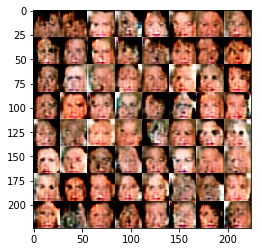

Epoch 1/1... Discriminator Loss: 0.9365... Generator Loss: 1.3639
Epoch 1/1... Discriminator Loss: 0.9989... Generator Loss: 0.7211
Epoch 1/1... Discriminator Loss: 0.5511... Generator Loss: 1.5983
Epoch 1/1... Discriminator Loss: 1.2700... Generator Loss: 0.4887
Epoch 1/1... Discriminator Loss: 1.0742... Generator Loss: 0.6253
Epoch 1/1... Discriminator Loss: 0.9443... Generator Loss: 0.7107
Epoch 1/1... Discriminator Loss: 0.9550... Generator Loss: 0.7451
Epoch 1/1... Discriminator Loss: 0.7165... Generator Loss: 1.1970
Epoch 1/1... Discriminator Loss: 1.2769... Generator Loss: 0.5617
Epoch 1/1... Discriminator Loss: 1.1812... Generator Loss: 0.5391


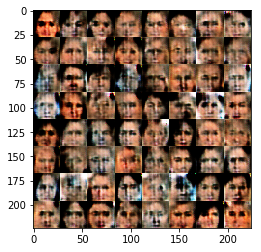

Epoch 1/1... Discriminator Loss: 1.1820... Generator Loss: 0.7166
Epoch 1/1... Discriminator Loss: 1.1491... Generator Loss: 0.7564
Epoch 1/1... Discriminator Loss: 1.2451... Generator Loss: 1.2459
Epoch 1/1... Discriminator Loss: 0.9463... Generator Loss: 1.5174
Epoch 1/1... Discriminator Loss: 0.9919... Generator Loss: 0.8181
Epoch 1/1... Discriminator Loss: 1.1047... Generator Loss: 1.0199
Epoch 1/1... Discriminator Loss: 1.1972... Generator Loss: 1.2963
Epoch 1/1... Discriminator Loss: 1.1787... Generator Loss: 0.6557
Epoch 1/1... Discriminator Loss: 1.1867... Generator Loss: 0.8062
Epoch 1/1... Discriminator Loss: 0.8758... Generator Loss: 0.9068


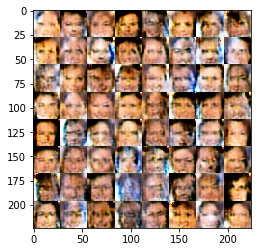

Epoch 1/1... Discriminator Loss: 1.1577... Generator Loss: 1.6728
Epoch 1/1... Discriminator Loss: 0.8355... Generator Loss: 1.8815
Epoch 1/1... Discriminator Loss: 0.7661... Generator Loss: 1.0921
Epoch 1/1... Discriminator Loss: 2.2734... Generator Loss: 1.4667
Epoch 1/1... Discriminator Loss: 0.9193... Generator Loss: 0.9549
Epoch 1/1... Discriminator Loss: 1.0010... Generator Loss: 0.7438
Epoch 1/1... Discriminator Loss: 1.0345... Generator Loss: 1.0548
Epoch 1/1... Discriminator Loss: 1.3120... Generator Loss: 0.6989
Epoch 1/1... Discriminator Loss: 0.9564... Generator Loss: 0.8370
Epoch 1/1... Discriminator Loss: 1.2648... Generator Loss: 0.5455


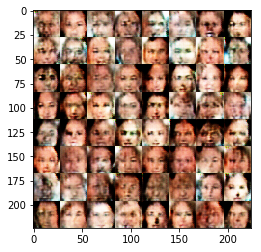

Epoch 1/1... Discriminator Loss: 1.2201... Generator Loss: 1.1838
Epoch 1/1... Discriminator Loss: 1.2215... Generator Loss: 0.9038
Epoch 1/1... Discriminator Loss: 1.0267... Generator Loss: 0.8097
Epoch 1/1... Discriminator Loss: 1.0028... Generator Loss: 0.7122
Epoch 1/1... Discriminator Loss: 1.3029... Generator Loss: 1.4259
Epoch 1/1... Discriminator Loss: 0.6183... Generator Loss: 1.3805
Epoch 1/1... Discriminator Loss: 1.3973... Generator Loss: 1.0596
Epoch 1/1... Discriminator Loss: 1.1424... Generator Loss: 0.7060
Epoch 1/1... Discriminator Loss: 1.2329... Generator Loss: 0.5176
Epoch 1/1... Discriminator Loss: 1.0482... Generator Loss: 1.2588


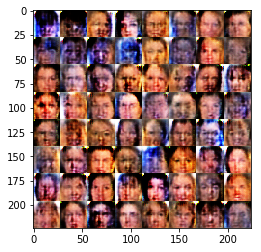

Epoch 1/1... Discriminator Loss: 1.2426... Generator Loss: 0.5763
Epoch 1/1... Discriminator Loss: 1.1215... Generator Loss: 1.1468
Epoch 1/1... Discriminator Loss: 1.1088... Generator Loss: 1.1202
Epoch 1/1... Discriminator Loss: 1.1516... Generator Loss: 0.7752
Epoch 1/1... Discriminator Loss: 1.1130... Generator Loss: 0.9935
Epoch 1/1... Discriminator Loss: 1.2410... Generator Loss: 1.2641
Epoch 1/1... Discriminator Loss: 1.2777... Generator Loss: 0.7436
Epoch 1/1... Discriminator Loss: 1.3699... Generator Loss: 0.6365
Epoch 1/1... Discriminator Loss: 1.0767... Generator Loss: 0.9153
Epoch 1/1... Discriminator Loss: 0.8984... Generator Loss: 0.8713


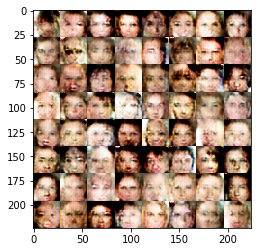

Epoch 1/1... Discriminator Loss: 1.0190... Generator Loss: 1.0481
Epoch 1/1... Discriminator Loss: 1.7810... Generator Loss: 0.3208
Epoch 1/1... Discriminator Loss: 1.2556... Generator Loss: 0.8414
Epoch 1/1... Discriminator Loss: 0.8888... Generator Loss: 1.1610
Epoch 1/1... Discriminator Loss: 1.0617... Generator Loss: 0.7740
Epoch 1/1... Discriminator Loss: 1.0632... Generator Loss: 0.8480
Epoch 1/1... Discriminator Loss: 1.2393... Generator Loss: 0.6982
Epoch 1/1... Discriminator Loss: 1.5714... Generator Loss: 0.3815
Epoch 1/1... Discriminator Loss: 1.1069... Generator Loss: 0.5407
Epoch 1/1... Discriminator Loss: 1.0533... Generator Loss: 1.2580


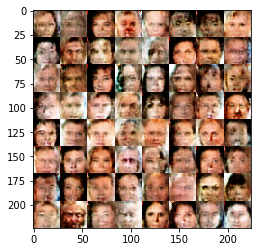

Epoch 1/1... Discriminator Loss: 0.8520... Generator Loss: 1.4270
Epoch 1/1... Discriminator Loss: 0.9805... Generator Loss: 1.4949
Epoch 1/1... Discriminator Loss: 0.9612... Generator Loss: 0.8165
Epoch 1/1... Discriminator Loss: 1.3282... Generator Loss: 0.7509
Epoch 1/1... Discriminator Loss: 1.2204... Generator Loss: 0.6581
Epoch 1/1... Discriminator Loss: 0.8391... Generator Loss: 1.2255
Epoch 1/1... Discriminator Loss: 1.1584... Generator Loss: 0.6232
Epoch 1/1... Discriminator Loss: 0.9222... Generator Loss: 0.9726
Epoch 1/1... Discriminator Loss: 0.9298... Generator Loss: 1.2050
Epoch 1/1... Discriminator Loss: 0.8011... Generator Loss: 1.0987


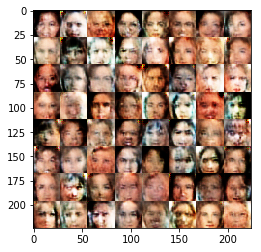

Epoch 1/1... Discriminator Loss: 1.3353... Generator Loss: 0.8055
Epoch 1/1... Discriminator Loss: 1.8867... Generator Loss: 1.0607
Epoch 1/1... Discriminator Loss: 1.1396... Generator Loss: 0.7578
Epoch 1/1... Discriminator Loss: 1.0109... Generator Loss: 0.7422
Epoch 1/1... Discriminator Loss: 1.2513... Generator Loss: 0.4626
Epoch 1/1... Discriminator Loss: 1.0739... Generator Loss: 0.9667
Epoch 1/1... Discriminator Loss: 1.2637... Generator Loss: 0.4674
Epoch 1/1... Discriminator Loss: 1.1587... Generator Loss: 1.1913
Epoch 1/1... Discriminator Loss: 1.1033... Generator Loss: 0.5929
Epoch 1/1... Discriminator Loss: 1.0567... Generator Loss: 0.8485


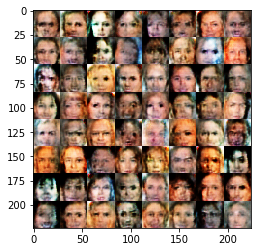

Epoch 1/1... Discriminator Loss: 1.1617... Generator Loss: 1.3454
Epoch 1/1... Discriminator Loss: 1.1544... Generator Loss: 0.9008
Epoch 1/1... Discriminator Loss: 1.4541... Generator Loss: 0.8194
Epoch 1/1... Discriminator Loss: 0.9135... Generator Loss: 1.2320
Epoch 1/1... Discriminator Loss: 1.4141... Generator Loss: 0.8267
Epoch 1/1... Discriminator Loss: 1.2055... Generator Loss: 0.8521
Epoch 1/1... Discriminator Loss: 0.8056... Generator Loss: 1.1066
Epoch 1/1... Discriminator Loss: 1.2134... Generator Loss: 0.5234
Epoch 1/1... Discriminator Loss: 1.1719... Generator Loss: 0.5783
Epoch 1/1... Discriminator Loss: 1.0979... Generator Loss: 1.8660


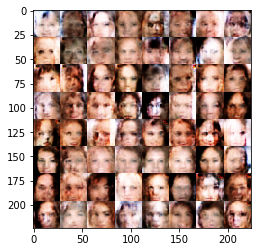

Epoch 1/1... Discriminator Loss: 0.7646... Generator Loss: 1.4851
Epoch 1/1... Discriminator Loss: 0.8811... Generator Loss: 0.7513
Epoch 1/1... Discriminator Loss: 1.4626... Generator Loss: 0.5571
Epoch 1/1... Discriminator Loss: 1.1338... Generator Loss: 0.7558
Epoch 1/1... Discriminator Loss: 1.2485... Generator Loss: 0.8322
Epoch 1/1... Discriminator Loss: 0.9786... Generator Loss: 0.8137
Epoch 1/1... Discriminator Loss: 1.1636... Generator Loss: 0.7022
Epoch 1/1... Discriminator Loss: 0.8859... Generator Loss: 1.3244
Epoch 1/1... Discriminator Loss: 0.9095... Generator Loss: 0.7978
Epoch 1/1... Discriminator Loss: 1.2001... Generator Loss: 0.5842


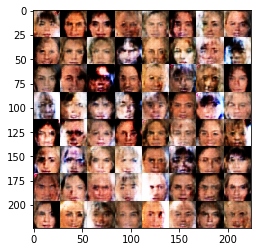

Epoch 1/1... Discriminator Loss: 0.9759... Generator Loss: 1.2228
Epoch 1/1... Discriminator Loss: 1.4832... Generator Loss: 0.5305
Epoch 1/1... Discriminator Loss: 1.0950... Generator Loss: 0.9833
Epoch 1/1... Discriminator Loss: 0.8780... Generator Loss: 0.7438
Epoch 1/1... Discriminator Loss: 1.2364... Generator Loss: 0.5041
Epoch 1/1... Discriminator Loss: 1.0298... Generator Loss: 0.8319
Epoch 1/1... Discriminator Loss: 1.4584... Generator Loss: 0.4150
Epoch 1/1... Discriminator Loss: 1.0198... Generator Loss: 0.7430
Epoch 1/1... Discriminator Loss: 1.0831... Generator Loss: 0.6756
Epoch 1/1... Discriminator Loss: 1.7277... Generator Loss: 1.4458


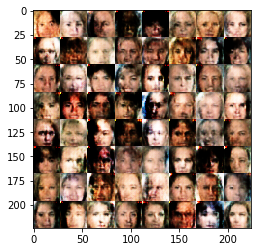

Epoch 1/1... Discriminator Loss: 1.2370... Generator Loss: 0.6810
Epoch 1/1... Discriminator Loss: 0.9130... Generator Loss: 1.0919
Epoch 1/1... Discriminator Loss: 1.2091... Generator Loss: 0.7516
Epoch 1/1... Discriminator Loss: 0.9613... Generator Loss: 0.7212
Epoch 1/1... Discriminator Loss: 1.2187... Generator Loss: 1.2086
Epoch 1/1... Discriminator Loss: 0.9072... Generator Loss: 1.2024
Epoch 1/1... Discriminator Loss: 1.0468... Generator Loss: 0.6725
Epoch 1/1... Discriminator Loss: 1.4069... Generator Loss: 0.4047
Epoch 1/1... Discriminator Loss: 0.4604... Generator Loss: 1.9593
Epoch 1/1... Discriminator Loss: 0.9059... Generator Loss: 1.6424


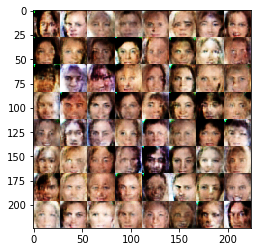

Epoch 1/1... Discriminator Loss: 1.1766... Generator Loss: 0.7976
Epoch 1/1... Discriminator Loss: 0.9635... Generator Loss: 1.1697
Epoch 1/1... Discriminator Loss: 0.8847... Generator Loss: 1.0415
Epoch 1/1... Discriminator Loss: 0.9965... Generator Loss: 0.8839
Epoch 1/1... Discriminator Loss: 1.2591... Generator Loss: 0.5208
Epoch 1/1... Discriminator Loss: 0.8356... Generator Loss: 0.9071
Epoch 1/1... Discriminator Loss: 1.2314... Generator Loss: 0.6893
Epoch 1/1... Discriminator Loss: 0.7616... Generator Loss: 1.1478
Epoch 1/1... Discriminator Loss: 0.7946... Generator Loss: 1.4825
Epoch 1/1... Discriminator Loss: 1.1237... Generator Loss: 0.7366


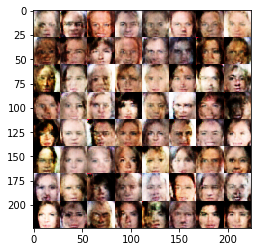

Epoch 1/1... Discriminator Loss: 0.9180... Generator Loss: 0.8679
Epoch 1/1... Discriminator Loss: 1.4513... Generator Loss: 1.3841
Epoch 1/1... Discriminator Loss: 1.0128... Generator Loss: 1.0446
Epoch 1/1... Discriminator Loss: 1.2008... Generator Loss: 0.6265
Epoch 1/1... Discriminator Loss: 1.0069... Generator Loss: 0.8179
Epoch 1/1... Discriminator Loss: 0.6523... Generator Loss: 1.7430
Epoch 1/1... Discriminator Loss: 1.1366... Generator Loss: 0.8555
Epoch 1/1... Discriminator Loss: 1.1939... Generator Loss: 0.5145
Epoch 1/1... Discriminator Loss: 0.7091... Generator Loss: 1.1738
Epoch 1/1... Discriminator Loss: 1.0488... Generator Loss: 1.0777


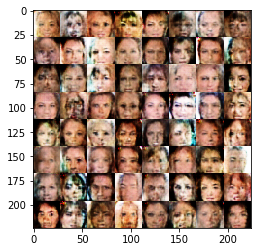

Epoch 1/1... Discriminator Loss: 0.9976... Generator Loss: 0.6914
Epoch 1/1... Discriminator Loss: 1.0666... Generator Loss: 1.4957
Epoch 1/1... Discriminator Loss: 0.5162... Generator Loss: 1.4632
Epoch 1/1... Discriminator Loss: 1.2648... Generator Loss: 0.4805
Epoch 1/1... Discriminator Loss: 0.9943... Generator Loss: 0.8416
Epoch 1/1... Discriminator Loss: 1.2579... Generator Loss: 0.4984
Epoch 1/1... Discriminator Loss: 1.3802... Generator Loss: 0.6581
Epoch 1/1... Discriminator Loss: 1.4712... Generator Loss: 0.4728
Epoch 1/1... Discriminator Loss: 1.1777... Generator Loss: 1.1232
Epoch 1/1... Discriminator Loss: 1.0850... Generator Loss: 0.8733


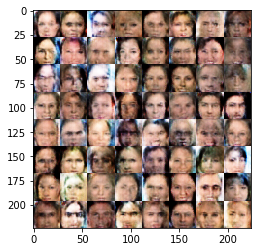

Epoch 1/1... Discriminator Loss: 0.9169... Generator Loss: 0.9435
Epoch 1/1... Discriminator Loss: 1.2057... Generator Loss: 0.6928
Epoch 1/1... Discriminator Loss: 0.8298... Generator Loss: 1.0467
Epoch 1/1... Discriminator Loss: 0.8901... Generator Loss: 0.8983
Epoch 1/1... Discriminator Loss: 1.1818... Generator Loss: 0.7249
Epoch 1/1... Discriminator Loss: 1.2632... Generator Loss: 0.6282
Epoch 1/1... Discriminator Loss: 0.6264... Generator Loss: 1.5802
Epoch 1/1... Discriminator Loss: 1.0545... Generator Loss: 0.9514
Epoch 1/1... Discriminator Loss: 1.5328... Generator Loss: 0.6613
Epoch 1/1... Discriminator Loss: 1.2028... Generator Loss: 0.6336


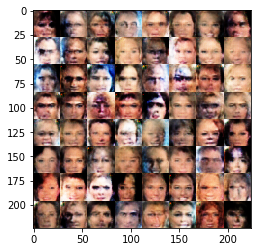

Epoch 1/1... Discriminator Loss: 1.0324... Generator Loss: 1.0716
Epoch 1/1... Discriminator Loss: 0.9887... Generator Loss: 0.9711
Epoch 1/1... Discriminator Loss: 0.9948... Generator Loss: 0.6235
Epoch 1/1... Discriminator Loss: 1.3237... Generator Loss: 0.5377
Epoch 1/1... Discriminator Loss: 1.2985... Generator Loss: 0.8719
Epoch 1/1... Discriminator Loss: 0.9749... Generator Loss: 0.9331
Epoch 1/1... Discriminator Loss: 0.9742... Generator Loss: 0.7705
Epoch 1/1... Discriminator Loss: 1.1744... Generator Loss: 0.7395
Epoch 1/1... Discriminator Loss: 0.9984... Generator Loss: 0.7945
Epoch 1/1... Discriminator Loss: 1.0113... Generator Loss: 0.8294


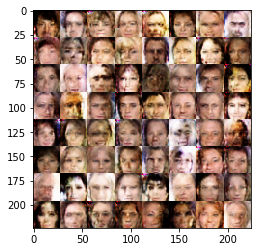

Epoch 1/1... Discriminator Loss: 1.1760... Generator Loss: 0.6579
Epoch 1/1... Discriminator Loss: 1.2735... Generator Loss: 0.6804
Epoch 1/1... Discriminator Loss: 1.1860... Generator Loss: 0.8685
Epoch 1/1... Discriminator Loss: 1.1164... Generator Loss: 1.2158
Epoch 1/1... Discriminator Loss: 1.0440... Generator Loss: 1.1182
Epoch 1/1... Discriminator Loss: 1.2460... Generator Loss: 0.9030
Epoch 1/1... Discriminator Loss: 1.2696... Generator Loss: 1.0384
Epoch 1/1... Discriminator Loss: 1.1634... Generator Loss: 0.5821
Epoch 1/1... Discriminator Loss: 1.0948... Generator Loss: 1.5354
Epoch 1/1... Discriminator Loss: 0.9635... Generator Loss: 0.7355


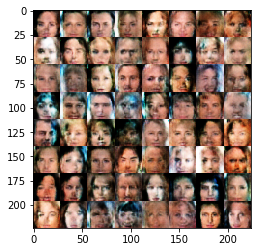

Epoch 1/1... Discriminator Loss: 1.2887... Generator Loss: 0.5798
Epoch 1/1... Discriminator Loss: 1.1290... Generator Loss: 0.7264
Epoch 1/1... Discriminator Loss: 1.1917... Generator Loss: 0.7662
Epoch 1/1... Discriminator Loss: 1.1472... Generator Loss: 0.9378
Epoch 1/1... Discriminator Loss: 1.1587... Generator Loss: 0.8983
Epoch 1/1... Discriminator Loss: 1.0811... Generator Loss: 0.7737
Epoch 1/1... Discriminator Loss: 1.2239... Generator Loss: 1.0789
Epoch 1/1... Discriminator Loss: 1.1664... Generator Loss: 1.0742
Epoch 1/1... Discriminator Loss: 1.2193... Generator Loss: 0.8780
Epoch 1/1... Discriminator Loss: 1.2322... Generator Loss: 0.6180


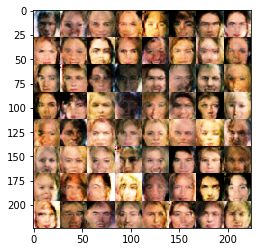

Epoch 1/1... Discriminator Loss: 1.5573... Generator Loss: 0.4361
Epoch 1/1... Discriminator Loss: 1.1925... Generator Loss: 1.0495
Epoch 1/1... Discriminator Loss: 1.4016... Generator Loss: 0.5308
Epoch 1/1... Discriminator Loss: 1.2056... Generator Loss: 0.7347
Epoch 1/1... Discriminator Loss: 1.1601... Generator Loss: 0.9852
Epoch 1/1... Discriminator Loss: 0.6077... Generator Loss: 1.2030
Epoch 1/1... Discriminator Loss: 1.2502... Generator Loss: 0.7755
Epoch 1/1... Discriminator Loss: 0.8830... Generator Loss: 1.0644
Epoch 1/1... Discriminator Loss: 1.2361... Generator Loss: 1.0274
Epoch 1/1... Discriminator Loss: 0.8881... Generator Loss: 0.8261


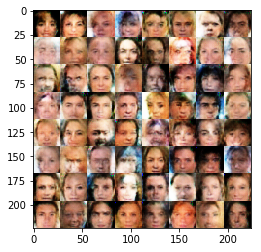

Epoch 1/1... Discriminator Loss: 1.1245... Generator Loss: 0.6360
Epoch 1/1... Discriminator Loss: 1.1668... Generator Loss: 1.3013
Epoch 1/1... Discriminator Loss: 0.9247... Generator Loss: 1.1531
Epoch 1/1... Discriminator Loss: 1.1719... Generator Loss: 0.6487
Epoch 1/1... Discriminator Loss: 1.3498... Generator Loss: 0.4660
Epoch 1/1... Discriminator Loss: 0.8278... Generator Loss: 1.2162
Epoch 1/1... Discriminator Loss: 1.1082... Generator Loss: 0.7092
Epoch 1/1... Discriminator Loss: 1.2721... Generator Loss: 1.2204
Epoch 1/1... Discriminator Loss: 1.3626... Generator Loss: 0.7668
Epoch 1/1... Discriminator Loss: 1.2682... Generator Loss: 0.6602


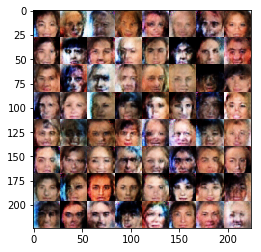

Epoch 1/1... Discriminator Loss: 0.9994... Generator Loss: 0.9495
Epoch 1/1... Discriminator Loss: 1.0240... Generator Loss: 0.7801
Epoch 1/1... Discriminator Loss: 0.8710... Generator Loss: 0.8205
Epoch 1/1... Discriminator Loss: 1.4232... Generator Loss: 0.6231
Epoch 1/1... Discriminator Loss: 1.0998... Generator Loss: 0.6985
Epoch 1/1... Discriminator Loss: 1.3431... Generator Loss: 0.8893
Epoch 1/1... Discriminator Loss: 0.7994... Generator Loss: 1.1492
Epoch 1/1... Discriminator Loss: 1.1650... Generator Loss: 0.8644
Epoch 1/1... Discriminator Loss: 0.9919... Generator Loss: 0.6922
Epoch 1/1... Discriminator Loss: 0.9485... Generator Loss: 1.1176


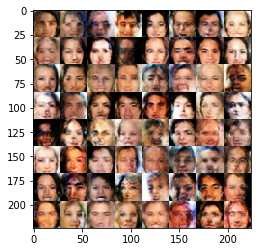

Epoch 1/1... Discriminator Loss: 1.3150... Generator Loss: 0.6635
Epoch 1/1... Discriminator Loss: 1.1374... Generator Loss: 0.5309
Epoch 1/1... Discriminator Loss: 1.2938... Generator Loss: 0.7333
Epoch 1/1... Discriminator Loss: 1.2821... Generator Loss: 0.5305
Epoch 1/1... Discriminator Loss: 0.8608... Generator Loss: 0.9686
Epoch 1/1... Discriminator Loss: 1.1473... Generator Loss: 0.9238
Epoch 1/1... Discriminator Loss: 1.3676... Generator Loss: 0.8567
Epoch 1/1... Discriminator Loss: 1.0052... Generator Loss: 0.8261
Epoch 1/1... Discriminator Loss: 0.8761... Generator Loss: 1.1378
Epoch 1/1... Discriminator Loss: 1.3235... Generator Loss: 0.4960


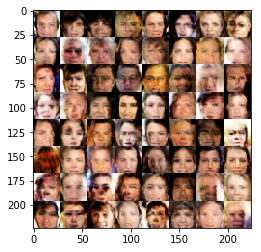

Epoch 1/1... Discriminator Loss: 1.0019... Generator Loss: 0.8214
Epoch 1/1... Discriminator Loss: 0.9329... Generator Loss: 0.8752
Epoch 1/1... Discriminator Loss: 1.1363... Generator Loss: 0.7771
Epoch 1/1... Discriminator Loss: 1.1940... Generator Loss: 0.5319
Epoch 1/1... Discriminator Loss: 1.0255... Generator Loss: 0.9862
Epoch 1/1... Discriminator Loss: 0.8210... Generator Loss: 0.9650
Epoch 1/1... Discriminator Loss: 1.1460... Generator Loss: 0.6061
Epoch 1/1... Discriminator Loss: 1.1918... Generator Loss: 0.6422
Epoch 1/1... Discriminator Loss: 0.9129... Generator Loss: 0.8936
Epoch 1/1... Discriminator Loss: 1.0210... Generator Loss: 1.6647


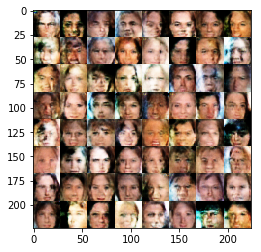

Epoch 1/1... Discriminator Loss: 0.9558... Generator Loss: 0.9910
Epoch 1/1... Discriminator Loss: 1.2225... Generator Loss: 1.0055
Epoch 1/1... Discriminator Loss: 1.2958... Generator Loss: 0.5836
Epoch 1/1... Discriminator Loss: 1.0411... Generator Loss: 0.6661
Epoch 1/1... Discriminator Loss: 1.0341... Generator Loss: 0.6492
Epoch 1/1... Discriminator Loss: 1.1905... Generator Loss: 0.6795
Epoch 1/1... Discriminator Loss: 1.0864... Generator Loss: 0.8382
Epoch 1/1... Discriminator Loss: 1.0202... Generator Loss: 0.7433
Epoch 1/1... Discriminator Loss: 1.2169... Generator Loss: 0.9165
Epoch 1/1... Discriminator Loss: 0.7972... Generator Loss: 1.2038


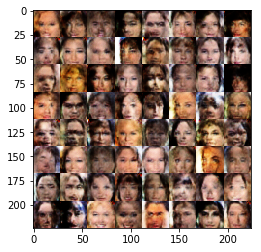

Epoch 1/1... Discriminator Loss: 0.9772... Generator Loss: 0.8138
Epoch 1/1... Discriminator Loss: 1.3330... Generator Loss: 0.8017
Epoch 1/1... Discriminator Loss: 0.8726... Generator Loss: 1.1051
Epoch 1/1... Discriminator Loss: 1.1209... Generator Loss: 0.8280
Epoch 1/1... Discriminator Loss: 0.9036... Generator Loss: 1.0355
Epoch 1/1... Discriminator Loss: 0.8877... Generator Loss: 0.8144
Epoch 1/1... Discriminator Loss: 0.7610... Generator Loss: 1.1871
Epoch 1/1... Discriminator Loss: 1.0008... Generator Loss: 0.7396
Epoch 1/1... Discriminator Loss: 1.2730... Generator Loss: 0.6577
Epoch 1/1... Discriminator Loss: 1.2179... Generator Loss: 0.6144


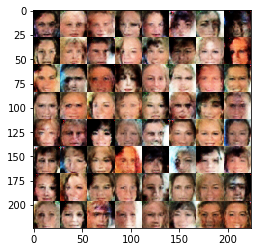

Epoch 1/1... Discriminator Loss: 1.0878... Generator Loss: 0.6745
Epoch 1/1... Discriminator Loss: 1.2997... Generator Loss: 0.6603
Epoch 1/1... Discriminator Loss: 0.7581... Generator Loss: 1.5330
Epoch 1/1... Discriminator Loss: 0.9510... Generator Loss: 0.7688
Epoch 1/1... Discriminator Loss: 1.3392... Generator Loss: 0.5032
Epoch 1/1... Discriminator Loss: 1.5247... Generator Loss: 0.4572
Epoch 1/1... Discriminator Loss: 1.0433... Generator Loss: 0.8433
Epoch 1/1... Discriminator Loss: 1.5509... Generator Loss: 0.3525
Epoch 1/1... Discriminator Loss: 1.0920... Generator Loss: 0.8125
Epoch 1/1... Discriminator Loss: 1.0573... Generator Loss: 0.8213


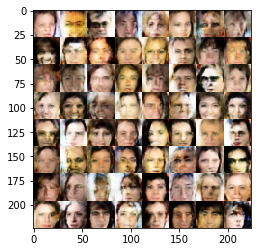

Epoch 1/1... Discriminator Loss: 1.4251... Generator Loss: 0.5136
Epoch 1/1... Discriminator Loss: 1.0553... Generator Loss: 0.8620
Epoch 1/1... Discriminator Loss: 1.2179... Generator Loss: 1.0075
Epoch 1/1... Discriminator Loss: 0.3880... Generator Loss: 2.7547
Epoch 1/1... Discriminator Loss: 0.4579... Generator Loss: 1.4645
Epoch 1/1... Discriminator Loss: 0.3035... Generator Loss: 2.1041
Epoch 1/1... Discriminator Loss: 0.4252... Generator Loss: 1.4596
Epoch 1/1... Discriminator Loss: 0.1921... Generator Loss: 2.5844
Epoch 1/1... Discriminator Loss: 0.2239... Generator Loss: 2.0632
Epoch 1/1... Discriminator Loss: 0.3972... Generator Loss: 1.6283


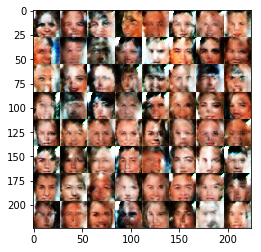

Epoch 1/1... Discriminator Loss: 1.3095... Generator Loss: 2.0076
Epoch 1/1... Discriminator Loss: 0.8097... Generator Loss: 0.9554
Epoch 1/1... Discriminator Loss: 0.8747... Generator Loss: 1.8965
Epoch 1/1... Discriminator Loss: 0.7782... Generator Loss: 1.0800
Epoch 1/1... Discriminator Loss: 0.4525... Generator Loss: 1.4265
Epoch 1/1... Discriminator Loss: 0.4039... Generator Loss: 1.4595
Epoch 1/1... Discriminator Loss: 0.3581... Generator Loss: 2.1511
Epoch 1/1... Discriminator Loss: 0.4727... Generator Loss: 1.6666
Epoch 1/1... Discriminator Loss: 0.5114... Generator Loss: 1.2485
Epoch 1/1... Discriminator Loss: 0.6878... Generator Loss: 1.0263


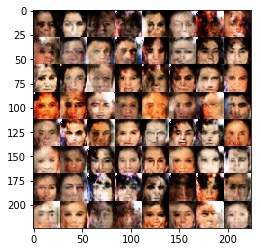

Epoch 1/1... Discriminator Loss: 1.3902... Generator Loss: 0.3470
Epoch 1/1... Discriminator Loss: 0.5082... Generator Loss: 1.3105
Epoch 1/1... Discriminator Loss: 1.6600... Generator Loss: 0.6549
Epoch 1/1... Discriminator Loss: 0.9310... Generator Loss: 1.4579
Epoch 1/1... Discriminator Loss: 1.1318... Generator Loss: 0.6257
Epoch 1/1... Discriminator Loss: 0.5154... Generator Loss: 1.3796
Epoch 1/1... Discriminator Loss: 0.3908... Generator Loss: 1.5436
Epoch 1/1... Discriminator Loss: 1.4465... Generator Loss: 0.5488
Epoch 1/1... Discriminator Loss: 1.1093... Generator Loss: 1.3271
Epoch 1/1... Discriminator Loss: 0.5449... Generator Loss: 1.1866


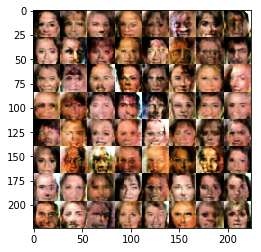

Epoch 1/1... Discriminator Loss: 0.9317... Generator Loss: 1.0917
Epoch 1/1... Discriminator Loss: 0.4142... Generator Loss: 1.5780
Epoch 1/1... Discriminator Loss: 0.3686... Generator Loss: 1.7092
Epoch 1/1... Discriminator Loss: 0.3965... Generator Loss: 1.5914
Epoch 1/1... Discriminator Loss: 0.9179... Generator Loss: 0.6168
Epoch 1/1... Discriminator Loss: 0.3383... Generator Loss: 4.1516
Epoch 1/1... Discriminator Loss: 0.6954... Generator Loss: 1.1854
Epoch 1/1... Discriminator Loss: 0.7274... Generator Loss: 1.4546
Epoch 1/1... Discriminator Loss: 1.2408... Generator Loss: 0.6520
Epoch 1/1... Discriminator Loss: 0.4766... Generator Loss: 2.0563


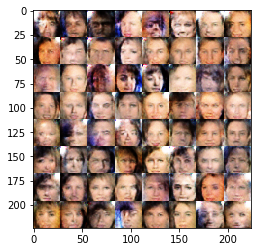

Epoch 1/1... Discriminator Loss: 0.7541... Generator Loss: 0.8814
Epoch 1/1... Discriminator Loss: 1.0050... Generator Loss: 1.0267
Epoch 1/1... Discriminator Loss: 0.4240... Generator Loss: 2.4324
Epoch 1/1... Discriminator Loss: 0.5918... Generator Loss: 1.0895
Epoch 1/1... Discriminator Loss: 0.3097... Generator Loss: 1.5496
Epoch 1/1... Discriminator Loss: 0.6573... Generator Loss: 0.9554
Epoch 1/1... Discriminator Loss: 0.7971... Generator Loss: 0.7596
Epoch 1/1... Discriminator Loss: 0.3237... Generator Loss: 1.6132
Epoch 1/1... Discriminator Loss: 1.0165... Generator Loss: 0.6023
Epoch 1/1... Discriminator Loss: 0.6612... Generator Loss: 1.0413


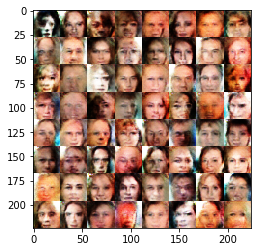

Epoch 1/1... Discriminator Loss: 1.1044... Generator Loss: 0.5102
Epoch 1/1... Discriminator Loss: 1.2582... Generator Loss: 0.4199
Epoch 1/1... Discriminator Loss: 1.1895... Generator Loss: 0.6029
Epoch 1/1... Discriminator Loss: 0.7418... Generator Loss: 1.2616
Epoch 1/1... Discriminator Loss: 1.2668... Generator Loss: 0.9319
Epoch 1/1... Discriminator Loss: 0.6467... Generator Loss: 1.2847
Epoch 1/1... Discriminator Loss: 1.1319... Generator Loss: 0.7218
Epoch 1/1... Discriminator Loss: 0.5135... Generator Loss: 1.5467
Epoch 1/1... Discriminator Loss: 1.0863... Generator Loss: 0.5975
Epoch 1/1... Discriminator Loss: 0.6036... Generator Loss: 1.1397


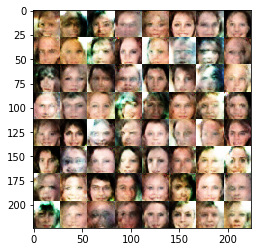

Epoch 1/1... Discriminator Loss: 0.6760... Generator Loss: 0.9708
Epoch 1/1... Discriminator Loss: 0.7755... Generator Loss: 1.7834
Epoch 1/1... Discriminator Loss: 0.5846... Generator Loss: 1.0879
Epoch 1/1... Discriminator Loss: 0.2140... Generator Loss: 2.5875
Epoch 1/1... Discriminator Loss: 0.5572... Generator Loss: 1.0572
Epoch 1/1... Discriminator Loss: 0.9579... Generator Loss: 0.8969
Epoch 1/1... Discriminator Loss: 1.4539... Generator Loss: 0.3117
Epoch 1/1... Discriminator Loss: 0.2323... Generator Loss: 3.1959
Epoch 1/1... Discriminator Loss: 0.8277... Generator Loss: 0.8012
Epoch 1/1... Discriminator Loss: 1.2490... Generator Loss: 1.1432


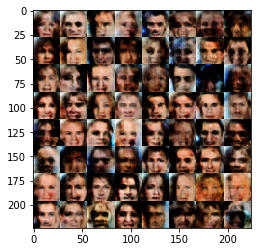

Epoch 1/1... Discriminator Loss: 1.1274... Generator Loss: 0.5419
Epoch 1/1... Discriminator Loss: 1.0456... Generator Loss: 0.6568
Epoch 1/1... Discriminator Loss: 1.1085... Generator Loss: 0.5873
Epoch 1/1... Discriminator Loss: 1.0687... Generator Loss: 0.8475
Epoch 1/1... Discriminator Loss: 0.6251... Generator Loss: 1.2208
Epoch 1/1... Discriminator Loss: 0.9333... Generator Loss: 0.9827
Epoch 1/1... Discriminator Loss: 0.9128... Generator Loss: 0.8433
Epoch 1/1... Discriminator Loss: 1.0556... Generator Loss: 0.7863
Epoch 1/1... Discriminator Loss: 1.3746... Generator Loss: 0.7295
Epoch 1/1... Discriminator Loss: 1.1132... Generator Loss: 1.0946


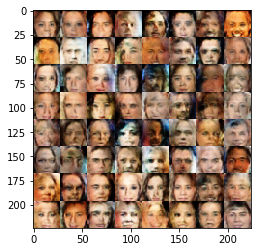

Epoch 1/1... Discriminator Loss: 1.1291... Generator Loss: 1.5248
Epoch 1/1... Discriminator Loss: 1.1730... Generator Loss: 1.0069
Epoch 1/1... Discriminator Loss: 1.2891... Generator Loss: 1.0138
Epoch 1/1... Discriminator Loss: 1.1624... Generator Loss: 0.6476
Epoch 1/1... Discriminator Loss: 1.2850... Generator Loss: 0.7131
Epoch 1/1... Discriminator Loss: 0.9237... Generator Loss: 1.0422
Epoch 1/1... Discriminator Loss: 1.1282... Generator Loss: 1.2718
Epoch 1/1... Discriminator Loss: 1.0301... Generator Loss: 1.0070
Epoch 1/1... Discriminator Loss: 1.1196... Generator Loss: 0.6167
Epoch 1/1... Discriminator Loss: 1.3856... Generator Loss: 0.5729


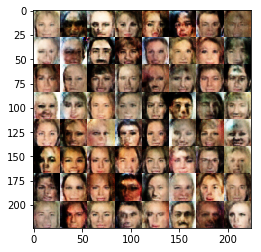

Epoch 1/1... Discriminator Loss: 1.4084... Generator Loss: 0.8577
Epoch 1/1... Discriminator Loss: 1.0678... Generator Loss: 0.8659
Epoch 1/1... Discriminator Loss: 1.1523... Generator Loss: 0.8358
Epoch 1/1... Discriminator Loss: 1.1838... Generator Loss: 0.7931
Epoch 1/1... Discriminator Loss: 0.5815... Generator Loss: 1.4627
Epoch 1/1... Discriminator Loss: 0.7969... Generator Loss: 1.2008
Epoch 1/1... Discriminator Loss: 1.1311... Generator Loss: 0.8394
Epoch 1/1... Discriminator Loss: 1.4839... Generator Loss: 0.8584
Epoch 1/1... Discriminator Loss: 1.1550... Generator Loss: 0.9319
Epoch 1/1... Discriminator Loss: 1.1521... Generator Loss: 1.0502


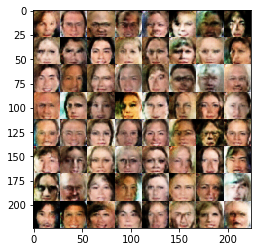

Epoch 1/1... Discriminator Loss: 1.0601... Generator Loss: 0.8157
Epoch 1/1... Discriminator Loss: 0.6755... Generator Loss: 1.4437
Epoch 1/1... Discriminator Loss: 1.1911... Generator Loss: 0.4940
Epoch 1/1... Discriminator Loss: 1.0128... Generator Loss: 0.7183
Epoch 1/1... Discriminator Loss: 0.9383... Generator Loss: 1.4420
Epoch 1/1... Discriminator Loss: 1.5676... Generator Loss: 1.2889
Epoch 1/1... Discriminator Loss: 1.3354... Generator Loss: 0.9685
Epoch 1/1... Discriminator Loss: 0.9413... Generator Loss: 1.0451
Epoch 1/1... Discriminator Loss: 1.4093... Generator Loss: 0.6290
Epoch 1/1... Discriminator Loss: 0.8553... Generator Loss: 0.8303


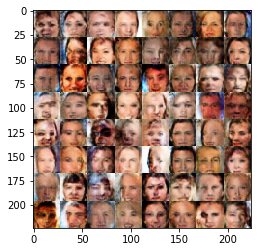

Epoch 1/1... Discriminator Loss: 1.0048... Generator Loss: 0.8694
Epoch 1/1... Discriminator Loss: 0.9993... Generator Loss: 1.1097
Epoch 1/1... Discriminator Loss: 0.9601... Generator Loss: 1.2947
Epoch 1/1... Discriminator Loss: 1.0506... Generator Loss: 0.9744
Epoch 1/1... Discriminator Loss: 1.0794... Generator Loss: 0.7212
Epoch 1/1... Discriminator Loss: 1.0680... Generator Loss: 1.1022
Epoch 1/1... Discriminator Loss: 0.9492... Generator Loss: 0.9526
Epoch 1/1... Discriminator Loss: 0.9976... Generator Loss: 0.9772
Epoch 1/1... Discriminator Loss: 1.0110... Generator Loss: 0.9273
Epoch 1/1... Discriminator Loss: 0.9677... Generator Loss: 0.9612


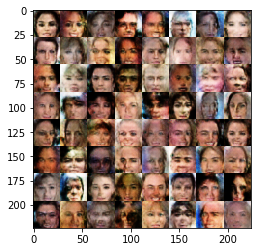

Epoch 1/1... Discriminator Loss: 1.3820... Generator Loss: 0.7094
Epoch 1/1... Discriminator Loss: 0.8892... Generator Loss: 1.0883
Epoch 1/1... Discriminator Loss: 1.0953... Generator Loss: 0.8263
Epoch 1/1... Discriminator Loss: 0.8973... Generator Loss: 0.7698
Epoch 1/1... Discriminator Loss: 0.9957... Generator Loss: 0.7511
Epoch 1/1... Discriminator Loss: 1.4360... Generator Loss: 0.5266
Epoch 1/1... Discriminator Loss: 1.0104... Generator Loss: 1.0482
Epoch 1/1... Discriminator Loss: 0.7929... Generator Loss: 1.3590
Epoch 1/1... Discriminator Loss: 1.0718... Generator Loss: 1.0218
Epoch 1/1... Discriminator Loss: 1.0050... Generator Loss: 0.7512


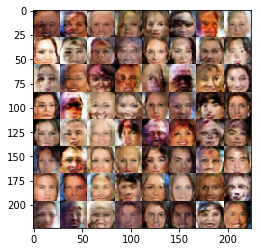

Epoch 1/1... Discriminator Loss: 1.1781... Generator Loss: 0.5604
Epoch 1/1... Discriminator Loss: 0.7381... Generator Loss: 1.2460
Epoch 1/1... Discriminator Loss: 1.1871... Generator Loss: 0.8052
Epoch 1/1... Discriminator Loss: 1.2527... Generator Loss: 0.8986
Epoch 1/1... Discriminator Loss: 0.8828... Generator Loss: 0.8445
Epoch 1/1... Discriminator Loss: 1.1828... Generator Loss: 0.8440
Epoch 1/1... Discriminator Loss: 0.4215... Generator Loss: 2.0031
Epoch 1/1... Discriminator Loss: 0.6931... Generator Loss: 1.0244
Epoch 1/1... Discriminator Loss: 0.6792... Generator Loss: 0.9867
Epoch 1/1... Discriminator Loss: 0.5653... Generator Loss: 1.2005


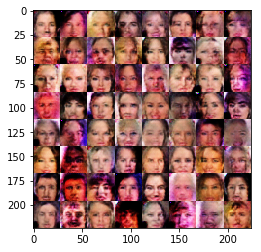

Epoch 1/1... Discriminator Loss: 1.5387... Generator Loss: 1.1353
Epoch 1/1... Discriminator Loss: 0.8390... Generator Loss: 1.2701
Epoch 1/1... Discriminator Loss: 1.0565... Generator Loss: 0.9879
Epoch 1/1... Discriminator Loss: 1.1265... Generator Loss: 1.2409
Epoch 1/1... Discriminator Loss: 0.9811... Generator Loss: 1.1066
Epoch 1/1... Discriminator Loss: 1.2172... Generator Loss: 0.8044
Epoch 1/1... Discriminator Loss: 1.1846... Generator Loss: 0.8679
Epoch 1/1... Discriminator Loss: 1.0343... Generator Loss: 0.9114
Epoch 1/1... Discriminator Loss: 1.3133... Generator Loss: 0.4791
Epoch 1/1... Discriminator Loss: 0.9469... Generator Loss: 0.9763


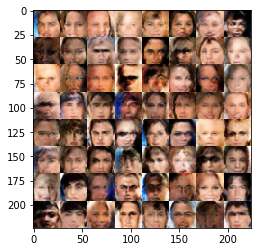

Epoch 1/1... Discriminator Loss: 1.0098... Generator Loss: 1.0143
Epoch 1/1... Discriminator Loss: 1.2261... Generator Loss: 0.6269
Epoch 1/1... Discriminator Loss: 0.8025... Generator Loss: 1.0294
Epoch 1/1... Discriminator Loss: 1.2189... Generator Loss: 0.6232
Epoch 1/1... Discriminator Loss: 1.3676... Generator Loss: 0.8936
Epoch 1/1... Discriminator Loss: 1.2070... Generator Loss: 0.7068
Epoch 1/1... Discriminator Loss: 1.5198... Generator Loss: 0.9044
Epoch 1/1... Discriminator Loss: 1.0960... Generator Loss: 0.7511
Epoch 1/1... Discriminator Loss: 0.8991... Generator Loss: 1.3778
Epoch 1/1... Discriminator Loss: 1.2376... Generator Loss: 0.8317


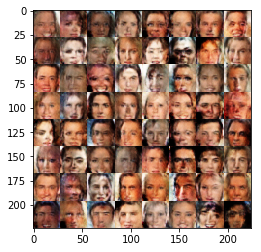

Epoch 1/1... Discriminator Loss: 1.4130... Generator Loss: 0.5074
Epoch 1/1... Discriminator Loss: 1.3268... Generator Loss: 0.6638
Epoch 1/1... Discriminator Loss: 1.0514... Generator Loss: 0.7816
Epoch 1/1... Discriminator Loss: 0.9927... Generator Loss: 0.9657
Epoch 1/1... Discriminator Loss: 1.0905... Generator Loss: 0.6753
Epoch 1/1... Discriminator Loss: 1.2807... Generator Loss: 0.7417
Epoch 1/1... Discriminator Loss: 1.0686... Generator Loss: 0.9593
Epoch 1/1... Discriminator Loss: 1.2346... Generator Loss: 0.7654
Epoch 1/1... Discriminator Loss: 0.7426... Generator Loss: 1.3032
Epoch 1/1... Discriminator Loss: 1.3710... Generator Loss: 0.7424


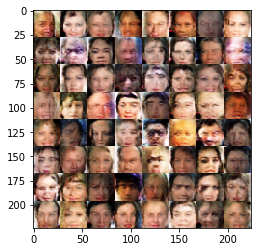

Epoch 1/1... Discriminator Loss: 1.3183... Generator Loss: 0.5032
Epoch 1/1... Discriminator Loss: 1.3460... Generator Loss: 0.9482
Epoch 1/1... Discriminator Loss: 0.4188... Generator Loss: 3.3690
Epoch 1/1... Discriminator Loss: 1.0162... Generator Loss: 0.9251
Epoch 1/1... Discriminator Loss: 1.1694... Generator Loss: 0.9036
Epoch 1/1... Discriminator Loss: 0.7977... Generator Loss: 0.9022
Epoch 1/1... Discriminator Loss: 1.1761... Generator Loss: 0.7296
Epoch 1/1... Discriminator Loss: 1.2177... Generator Loss: 0.9122
Epoch 1/1... Discriminator Loss: 1.0654... Generator Loss: 0.8534
Epoch 1/1... Discriminator Loss: 1.6399... Generator Loss: 0.3708


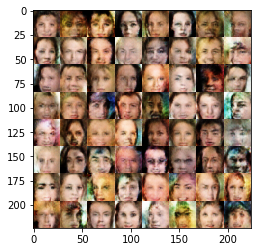

Epoch 1/1... Discriminator Loss: 1.1278... Generator Loss: 0.9825
Epoch 1/1... Discriminator Loss: 1.0544... Generator Loss: 0.8277
Epoch 1/1... Discriminator Loss: 1.0258... Generator Loss: 1.4833
Epoch 1/1... Discriminator Loss: 0.9546... Generator Loss: 1.0165
Epoch 1/1... Discriminator Loss: 0.8531... Generator Loss: 1.0310
Epoch 1/1... Discriminator Loss: 1.1294... Generator Loss: 0.8248
Epoch 1/1... Discriminator Loss: 1.1942... Generator Loss: 0.7098
Epoch 1/1... Discriminator Loss: 1.0891... Generator Loss: 0.7235
Epoch 1/1... Discriminator Loss: 1.0639... Generator Loss: 0.8651
Epoch 1/1... Discriminator Loss: 1.0515... Generator Loss: 0.8001


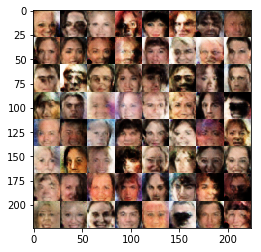

Epoch 1/1... Discriminator Loss: 1.2932... Generator Loss: 0.6163
Epoch 1/1... Discriminator Loss: 1.0683... Generator Loss: 0.7653
Epoch 1/1... Discriminator Loss: 1.1684... Generator Loss: 0.7947
Epoch 1/1... Discriminator Loss: 1.0839... Generator Loss: 0.9337
Epoch 1/1... Discriminator Loss: 0.9718... Generator Loss: 0.8485
Epoch 1/1... Discriminator Loss: 0.8638... Generator Loss: 1.0390
Epoch 1/1... Discriminator Loss: 0.6980... Generator Loss: 1.2763
Epoch 1/1... Discriminator Loss: 1.0978... Generator Loss: 0.7899
Epoch 1/1... Discriminator Loss: 1.1033... Generator Loss: 0.8828
Epoch 1/1... Discriminator Loss: 1.1209... Generator Loss: 0.8102


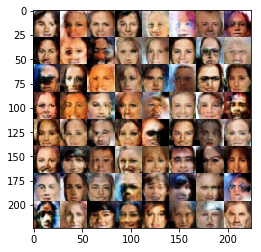

Epoch 1/1... Discriminator Loss: 1.2344... Generator Loss: 0.6356
Epoch 1/1... Discriminator Loss: 0.5782... Generator Loss: 1.8992
Epoch 1/1... Discriminator Loss: 1.1632... Generator Loss: 1.0459
Epoch 1/1... Discriminator Loss: 1.3233... Generator Loss: 0.5627
Epoch 1/1... Discriminator Loss: 1.1028... Generator Loss: 0.6517
Epoch 1/1... Discriminator Loss: 1.1951... Generator Loss: 0.7948
Epoch 1/1... Discriminator Loss: 1.3411... Generator Loss: 0.7523
Epoch 1/1... Discriminator Loss: 1.1188... Generator Loss: 0.7255
Epoch 1/1... Discriminator Loss: 1.1149... Generator Loss: 1.4606
Epoch 1/1... Discriminator Loss: 1.3798... Generator Loss: 1.1010


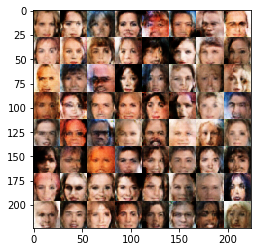

Epoch 1/1... Discriminator Loss: 1.1273... Generator Loss: 0.9468
Epoch 1/1... Discriminator Loss: 0.9142... Generator Loss: 0.7333
Epoch 1/1... Discriminator Loss: 1.3961... Generator Loss: 0.4734
Epoch 1/1... Discriminator Loss: 1.1593... Generator Loss: 0.8012
Epoch 1/1... Discriminator Loss: 1.0413... Generator Loss: 0.8675
Epoch 1/1... Discriminator Loss: 1.0510... Generator Loss: 1.1505
Epoch 1/1... Discriminator Loss: 1.1241... Generator Loss: 0.8612
Epoch 1/1... Discriminator Loss: 1.0260... Generator Loss: 0.9243
Epoch 1/1... Discriminator Loss: 1.2600... Generator Loss: 0.7021
Epoch 1/1... Discriminator Loss: 1.1881... Generator Loss: 0.9035


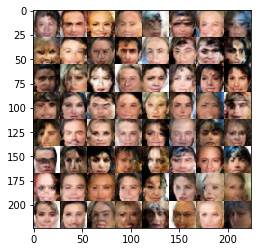

Epoch 1/1... Discriminator Loss: 0.7744... Generator Loss: 1.5073
Epoch 1/1... Discriminator Loss: 1.0906... Generator Loss: 1.1691
Epoch 1/1... Discriminator Loss: 1.0886... Generator Loss: 0.7187
Epoch 1/1... Discriminator Loss: 1.2042... Generator Loss: 0.8330
Epoch 1/1... Discriminator Loss: 1.2175... Generator Loss: 0.6384
Epoch 1/1... Discriminator Loss: 1.1707... Generator Loss: 0.7657
Epoch 1/1... Discriminator Loss: 1.1484... Generator Loss: 0.9396
Epoch 1/1... Discriminator Loss: 1.1789... Generator Loss: 0.7015
Epoch 1/1... Discriminator Loss: 1.1371... Generator Loss: 0.8289
Epoch 1/1... Discriminator Loss: 1.0486... Generator Loss: 1.0099


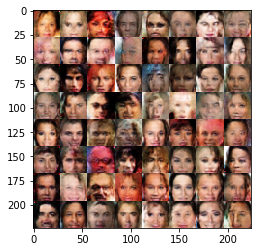

Epoch 1/1... Discriminator Loss: 1.2048... Generator Loss: 0.8277
Epoch 1/1... Discriminator Loss: 1.3339... Generator Loss: 0.6923
Epoch 1/1... Discriminator Loss: 1.1971... Generator Loss: 0.6076
Epoch 1/1... Discriminator Loss: 1.0710... Generator Loss: 0.9912
Epoch 1/1... Discriminator Loss: 1.1299... Generator Loss: 0.6242
Epoch 1/1... Discriminator Loss: 1.0711... Generator Loss: 0.7596
Epoch 1/1... Discriminator Loss: 1.0667... Generator Loss: 0.8170
Epoch 1/1... Discriminator Loss: 0.9819... Generator Loss: 0.9291
Epoch 1/1... Discriminator Loss: 1.6712... Generator Loss: 0.5281
Epoch 1/1... Discriminator Loss: 0.6138... Generator Loss: 1.4121


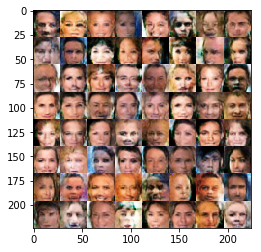

Epoch 1/1... Discriminator Loss: 0.6457... Generator Loss: 1.2470
Epoch 1/1... Discriminator Loss: 1.1754... Generator Loss: 0.7563
Epoch 1/1... Discriminator Loss: 1.5182... Generator Loss: 0.8186
Epoch 1/1... Discriminator Loss: 1.2987... Generator Loss: 0.7370
Epoch 1/1... Discriminator Loss: 1.2496... Generator Loss: 0.7468
Epoch 1/1... Discriminator Loss: 1.3489... Generator Loss: 0.5145
Epoch 1/1... Discriminator Loss: 1.0541... Generator Loss: 0.9284
Epoch 1/1... Discriminator Loss: 1.2400... Generator Loss: 0.7472
Epoch 1/1... Discriminator Loss: 1.1301... Generator Loss: 0.8975
Epoch 1/1... Discriminator Loss: 1.2898... Generator Loss: 0.6975


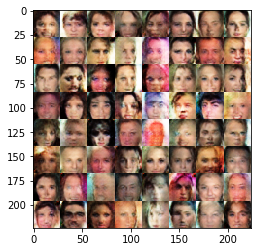

Epoch 1/1... Discriminator Loss: 1.2257... Generator Loss: 0.7282
Epoch 1/1... Discriminator Loss: 1.0662... Generator Loss: 0.8168
Epoch 1/1... Discriminator Loss: 1.1025... Generator Loss: 0.8206
Epoch 1/1... Discriminator Loss: 1.3406... Generator Loss: 0.6080
Epoch 1/1... Discriminator Loss: 1.0939... Generator Loss: 0.8049
Epoch 1/1... Discriminator Loss: 1.1399... Generator Loss: 0.7679
Epoch 1/1... Discriminator Loss: 1.0889... Generator Loss: 0.8186
Epoch 1/1... Discriminator Loss: 1.1200... Generator Loss: 0.7726
Epoch 1/1... Discriminator Loss: 0.9666... Generator Loss: 0.9479
Epoch 1/1... Discriminator Loss: 1.1570... Generator Loss: 0.8472


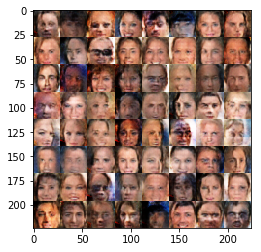

Epoch 1/1... Discriminator Loss: 1.0233... Generator Loss: 0.8925
Epoch 1/1... Discriminator Loss: 0.8951... Generator Loss: 1.0380
Epoch 1/1... Discriminator Loss: 1.2497... Generator Loss: 0.6023
Epoch 1/1... Discriminator Loss: 1.2261... Generator Loss: 0.7445
Epoch 1/1... Discriminator Loss: 0.7651... Generator Loss: 0.9572
Epoch 1/1... Discriminator Loss: 0.8348... Generator Loss: 1.2920
Epoch 1/1... Discriminator Loss: 1.0170... Generator Loss: 0.8161
Epoch 1/1... Discriminator Loss: 1.1029... Generator Loss: 0.6101
Epoch 1/1... Discriminator Loss: 1.0586... Generator Loss: 0.6938
Epoch 1/1... Discriminator Loss: 1.4365... Generator Loss: 0.5464


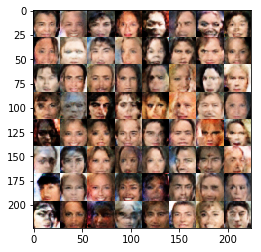

Epoch 1/1... Discriminator Loss: 1.2229... Generator Loss: 0.9087
Epoch 1/1... Discriminator Loss: 1.4428... Generator Loss: 0.5957
Epoch 1/1... Discriminator Loss: 1.3237... Generator Loss: 0.6144
Epoch 1/1... Discriminator Loss: 1.2230... Generator Loss: 0.5943
Epoch 1/1... Discriminator Loss: 1.1075... Generator Loss: 0.9314
Epoch 1/1... Discriminator Loss: 1.0043... Generator Loss: 0.8960
Epoch 1/1... Discriminator Loss: 1.1615... Generator Loss: 0.7897
Epoch 1/1... Discriminator Loss: 1.1111... Generator Loss: 0.7913
Epoch 1/1... Discriminator Loss: 0.9909... Generator Loss: 0.9426
Epoch 1/1... Discriminator Loss: 1.3068... Generator Loss: 0.6809


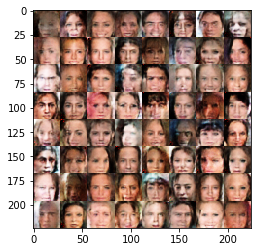

Epoch 1/1... Discriminator Loss: 1.2414... Generator Loss: 0.7094
Epoch 1/1... Discriminator Loss: 1.0441... Generator Loss: 1.0739
Epoch 1/1... Discriminator Loss: 1.3275... Generator Loss: 0.8711
Epoch 1/1... Discriminator Loss: 1.1911... Generator Loss: 0.8735
Epoch 1/1... Discriminator Loss: 1.0965... Generator Loss: 0.7156
Epoch 1/1... Discriminator Loss: 1.2656... Generator Loss: 0.6163
Epoch 1/1... Discriminator Loss: 1.5866... Generator Loss: 1.0356
Epoch 1/1... Discriminator Loss: 1.2292... Generator Loss: 0.7697
Epoch 1/1... Discriminator Loss: 1.0557... Generator Loss: 0.9142
Epoch 1/1... Discriminator Loss: 1.0476... Generator Loss: 0.8204


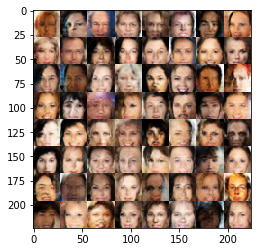

Epoch 1/1... Discriminator Loss: 1.3342... Generator Loss: 0.8408
Epoch 1/1... Discriminator Loss: 1.1786... Generator Loss: 0.7251
Epoch 1/1... Discriminator Loss: 0.9345... Generator Loss: 1.0265
Epoch 1/1... Discriminator Loss: 1.0867... Generator Loss: 0.8694
Epoch 1/1... Discriminator Loss: 1.2023... Generator Loss: 0.7840
Epoch 1/1... Discriminator Loss: 1.2585... Generator Loss: 0.8195
Epoch 1/1... Discriminator Loss: 1.0193... Generator Loss: 0.9337
Epoch 1/1... Discriminator Loss: 1.3603... Generator Loss: 0.8352
Epoch 1/1... Discriminator Loss: 1.0992... Generator Loss: 0.7055
Epoch 1/1... Discriminator Loss: 1.0287... Generator Loss: 0.8868


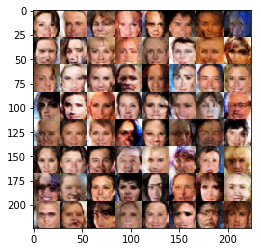

Epoch 1/1... Discriminator Loss: 1.3623... Generator Loss: 1.0144
Epoch 1/1... Discriminator Loss: 1.2340... Generator Loss: 0.7299
Epoch 1/1... Discriminator Loss: 1.3454... Generator Loss: 0.6593
Epoch 1/1... Discriminator Loss: 1.0995... Generator Loss: 0.9112
Epoch 1/1... Discriminator Loss: 1.1449... Generator Loss: 0.6497
Epoch 1/1... Discriminator Loss: 0.9985... Generator Loss: 0.8776
Epoch 1/1... Discriminator Loss: 1.2505... Generator Loss: 0.7347
Epoch 1/1... Discriminator Loss: 1.1060... Generator Loss: 0.7686
Epoch 1/1... Discriminator Loss: 1.2633... Generator Loss: 0.4988
Epoch 1/1... Discriminator Loss: 1.0959... Generator Loss: 1.0096


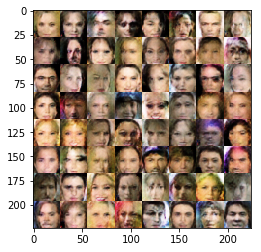

Epoch 1/1... Discriminator Loss: 1.1094... Generator Loss: 0.9161
Epoch 1/1... Discriminator Loss: 1.1253... Generator Loss: 0.7327
Epoch 1/1... Discriminator Loss: 0.9784... Generator Loss: 0.8854
Epoch 1/1... Discriminator Loss: 0.9032... Generator Loss: 1.0747
Epoch 1/1... Discriminator Loss: 1.4785... Generator Loss: 0.7375
Epoch 1/1... Discriminator Loss: 1.2460... Generator Loss: 0.6808
Epoch 1/1... Discriminator Loss: 1.0347... Generator Loss: 0.8479
Epoch 1/1... Discriminator Loss: 1.4406... Generator Loss: 0.4940
Epoch 1/1... Discriminator Loss: 1.1391... Generator Loss: 0.8115
Epoch 1/1... Discriminator Loss: 0.9185... Generator Loss: 1.1479


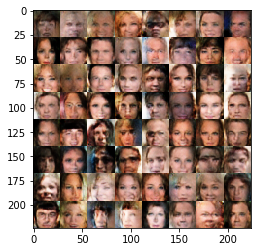

Epoch 1/1... Discriminator Loss: 0.7886... Generator Loss: 1.0939
Epoch 1/1... Discriminator Loss: 1.1145... Generator Loss: 0.6819
Epoch 1/1... Discriminator Loss: 1.1214... Generator Loss: 0.6420
Epoch 1/1... Discriminator Loss: 1.1636... Generator Loss: 0.6448
Epoch 1/1... Discriminator Loss: 1.3737... Generator Loss: 0.6799
Epoch 1/1... Discriminator Loss: 1.1939... Generator Loss: 0.7320
Epoch 1/1... Discriminator Loss: 1.0332... Generator Loss: 0.7822
Epoch 1/1... Discriminator Loss: 1.1292... Generator Loss: 0.9734
Epoch 1/1... Discriminator Loss: 1.0966... Generator Loss: 0.7278
Epoch 1/1... Discriminator Loss: 1.1640... Generator Loss: 0.6860


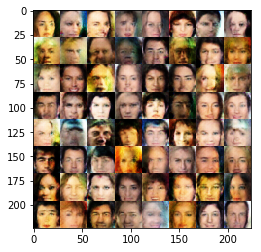

Epoch 1/1... Discriminator Loss: 0.9473... Generator Loss: 1.1370
Epoch 1/1... Discriminator Loss: 1.3247... Generator Loss: 0.5080
Epoch 1/1... Discriminator Loss: 0.9314... Generator Loss: 1.0560
Epoch 1/1... Discriminator Loss: 1.4239... Generator Loss: 0.6135
Epoch 1/1... Discriminator Loss: 0.8382... Generator Loss: 0.9221
Epoch 1/1... Discriminator Loss: 1.2578... Generator Loss: 0.6274
Epoch 1/1... Discriminator Loss: 1.2075... Generator Loss: 0.7250
Epoch 1/1... Discriminator Loss: 1.0249... Generator Loss: 0.9440
Epoch 1/1... Discriminator Loss: 1.3012... Generator Loss: 0.6301
Epoch 1/1... Discriminator Loss: 1.0683... Generator Loss: 0.7948


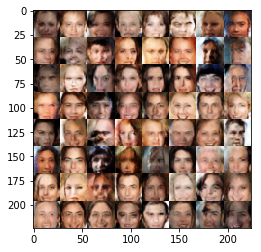

Epoch 1/1... Discriminator Loss: 0.9261... Generator Loss: 1.1598
Epoch 1/1... Discriminator Loss: 1.1384... Generator Loss: 0.6875
Epoch 1/1... Discriminator Loss: 1.3535... Generator Loss: 0.7081
Epoch 1/1... Discriminator Loss: 1.1840... Generator Loss: 0.6725
Epoch 1/1... Discriminator Loss: 1.0890... Generator Loss: 0.7484
Epoch 1/1... Discriminator Loss: 0.9340... Generator Loss: 0.9792
Epoch 1/1... Discriminator Loss: 1.2061... Generator Loss: 0.5657
Epoch 1/1... Discriminator Loss: 1.0600... Generator Loss: 0.9385
Epoch 1/1... Discriminator Loss: 1.3180... Generator Loss: 0.4437
Epoch 1/1... Discriminator Loss: 1.0487... Generator Loss: 0.7118


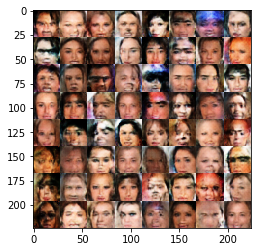

Epoch 1/1... Discriminator Loss: 1.7773... Generator Loss: 2.0771
Epoch 1/1... Discriminator Loss: 1.0062... Generator Loss: 0.8831
Epoch 1/1... Discriminator Loss: 1.1187... Generator Loss: 0.7276
Epoch 1/1... Discriminator Loss: 0.8925... Generator Loss: 1.0417
Epoch 1/1... Discriminator Loss: 1.2043... Generator Loss: 0.7600
Epoch 1/1... Discriminator Loss: 1.4789... Generator Loss: 0.8640
Epoch 1/1... Discriminator Loss: 1.1427... Generator Loss: 0.8154
Epoch 1/1... Discriminator Loss: 1.7666... Generator Loss: 0.8261
Epoch 1/1... Discriminator Loss: 0.9779... Generator Loss: 0.8840
Epoch 1/1... Discriminator Loss: 0.9763... Generator Loss: 0.8405


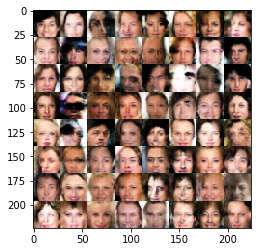

Epoch 1/1... Discriminator Loss: 1.1019... Generator Loss: 0.7775
Epoch 1/1... Discriminator Loss: 1.0023... Generator Loss: 0.8846
Epoch 1/1... Discriminator Loss: 1.0771... Generator Loss: 0.8515
Epoch 1/1... Discriminator Loss: 1.2733... Generator Loss: 0.6573
Epoch 1/1... Discriminator Loss: 1.1929... Generator Loss: 0.6033
Epoch 1/1... Discriminator Loss: 1.4271... Generator Loss: 0.7706
Epoch 1/1... Discriminator Loss: 1.1234... Generator Loss: 0.6659
Epoch 1/1... Discriminator Loss: 1.1505... Generator Loss: 0.7520
Epoch 1/1... Discriminator Loss: 1.3041... Generator Loss: 0.4526
Epoch 1/1... Discriminator Loss: 0.9193... Generator Loss: 0.7956


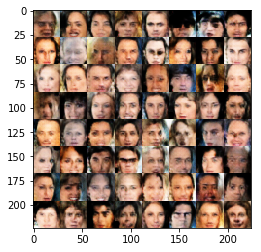

Epoch 1/1... Discriminator Loss: 1.4772... Generator Loss: 0.8288
Epoch 1/1... Discriminator Loss: 0.8412... Generator Loss: 1.1021
Epoch 1/1... Discriminator Loss: 1.1065... Generator Loss: 0.8424
Epoch 1/1... Discriminator Loss: 1.0185... Generator Loss: 0.9364
Epoch 1/1... Discriminator Loss: 1.1924... Generator Loss: 0.8157
Epoch 1/1... Discriminator Loss: 1.1068... Generator Loss: 0.8767
Epoch 1/1... Discriminator Loss: 1.1054... Generator Loss: 0.6162
Epoch 1/1... Discriminator Loss: 1.3354... Generator Loss: 0.8176
Epoch 1/1... Discriminator Loss: 1.1534... Generator Loss: 0.6267
Epoch 1/1... Discriminator Loss: 0.7916... Generator Loss: 1.1888


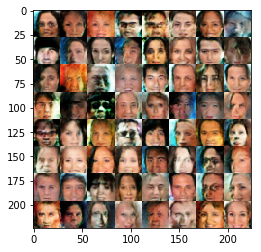

Epoch 1/1... Discriminator Loss: 1.3150... Generator Loss: 0.6347
Epoch 1/1... Discriminator Loss: 1.1470... Generator Loss: 0.6389
Epoch 1/1... Discriminator Loss: 1.0136... Generator Loss: 0.7951
Epoch 1/1... Discriminator Loss: 1.0124... Generator Loss: 1.0540
Epoch 1/1... Discriminator Loss: 1.2294... Generator Loss: 0.7067
Epoch 1/1... Discriminator Loss: 1.1262... Generator Loss: 0.5971
Epoch 1/1... Discriminator Loss: 1.3370... Generator Loss: 0.6126
Epoch 1/1... Discriminator Loss: 1.0985... Generator Loss: 0.9593
Epoch 1/1... Discriminator Loss: 1.2234... Generator Loss: 0.5832
Epoch 1/1... Discriminator Loss: 0.9385... Generator Loss: 0.9930


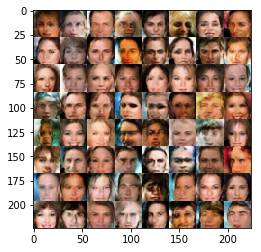

Epoch 1/1... Discriminator Loss: 1.3345... Generator Loss: 0.8441
Epoch 1/1... Discriminator Loss: 1.0959... Generator Loss: 0.6719
Epoch 1/1... Discriminator Loss: 1.1476... Generator Loss: 0.6352
Epoch 1/1... Discriminator Loss: 1.4399... Generator Loss: 0.6010
Epoch 1/1... Discriminator Loss: 0.9091... Generator Loss: 1.2405
Epoch 1/1... Discriminator Loss: 1.0479... Generator Loss: 1.0439
Epoch 1/1... Discriminator Loss: 1.0122... Generator Loss: 0.8535
Epoch 1/1... Discriminator Loss: 1.0741... Generator Loss: 0.7891
Epoch 1/1... Discriminator Loss: 1.2615... Generator Loss: 0.5693
Epoch 1/1... Discriminator Loss: 1.1242... Generator Loss: 0.7346


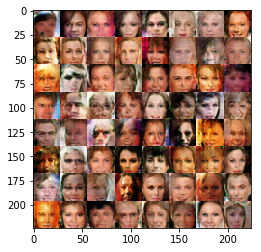

Epoch 1/1... Discriminator Loss: 1.3334... Generator Loss: 0.5331
Epoch 1/1... Discriminator Loss: 1.1253... Generator Loss: 0.6874
Epoch 1/1... Discriminator Loss: 1.2211... Generator Loss: 0.6759
Epoch 1/1... Discriminator Loss: 1.0926... Generator Loss: 0.6477
Epoch 1/1... Discriminator Loss: 1.2365... Generator Loss: 1.0285
Epoch 1/1... Discriminator Loss: 1.1346... Generator Loss: 0.8070
Epoch 1/1... Discriminator Loss: 1.2569... Generator Loss: 0.7906
Epoch 1/1... Discriminator Loss: 1.1906... Generator Loss: 0.9645
Epoch 1/1... Discriminator Loss: 1.3970... Generator Loss: 0.6417
Epoch 1/1... Discriminator Loss: 0.9548... Generator Loss: 0.9774


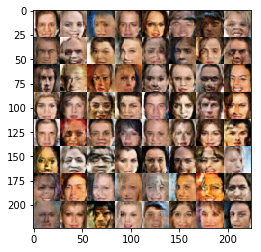

Epoch 1/1... Discriminator Loss: 1.4428... Generator Loss: 0.7862
Epoch 1/1... Discriminator Loss: 1.2087... Generator Loss: 0.8347
Epoch 1/1... Discriminator Loss: 1.0222... Generator Loss: 0.8621
Epoch 1/1... Discriminator Loss: 1.2301... Generator Loss: 1.0646
Epoch 1/1... Discriminator Loss: 1.2766... Generator Loss: 0.7245
Epoch 1/1... Discriminator Loss: 1.3058... Generator Loss: 0.7176
Epoch 1/1... Discriminator Loss: 1.1491... Generator Loss: 1.1272
Epoch 1/1... Discriminator Loss: 1.1748... Generator Loss: 0.8972
Epoch 1/1... Discriminator Loss: 1.3222... Generator Loss: 0.7474
Epoch 1/1... Discriminator Loss: 0.7058... Generator Loss: 1.4037


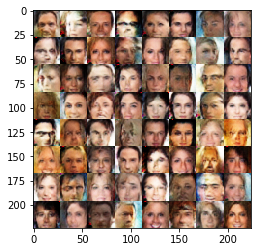

Epoch 1/1... Discriminator Loss: 1.8174... Generator Loss: 1.4667
Epoch 1/1... Discriminator Loss: 1.0802... Generator Loss: 0.8117
Epoch 1/1... Discriminator Loss: 0.7847... Generator Loss: 0.9529
Epoch 1/1... Discriminator Loss: 1.5434... Generator Loss: 0.6278
Epoch 1/1... Discriminator Loss: 1.1469... Generator Loss: 0.7230
Epoch 1/1... Discriminator Loss: 1.2354... Generator Loss: 0.7242
Epoch 1/1... Discriminator Loss: 1.2075... Generator Loss: 0.5680
Epoch 1/1... Discriminator Loss: 1.1775... Generator Loss: 0.7212
Epoch 1/1... Discriminator Loss: 1.1653... Generator Loss: 0.7462
Epoch 1/1... Discriminator Loss: 1.2984... Generator Loss: 0.7570


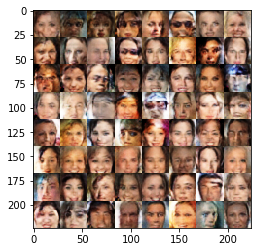

Epoch 1/1... Discriminator Loss: 0.9809... Generator Loss: 0.8913
Epoch 1/1... Discriminator Loss: 1.2498... Generator Loss: 0.6955
Epoch 1/1... Discriminator Loss: 1.0692... Generator Loss: 0.6870
Epoch 1/1... Discriminator Loss: 1.3711... Generator Loss: 0.6637
Epoch 1/1... Discriminator Loss: 1.1280... Generator Loss: 0.9011
Epoch 1/1... Discriminator Loss: 1.2572... Generator Loss: 0.6472
Epoch 1/1... Discriminator Loss: 0.7070... Generator Loss: 1.7740
Epoch 1/1... Discriminator Loss: 1.0678... Generator Loss: 0.8812
Epoch 1/1... Discriminator Loss: 1.0725... Generator Loss: 1.1742
Epoch 1/1... Discriminator Loss: 1.1938... Generator Loss: 0.8894


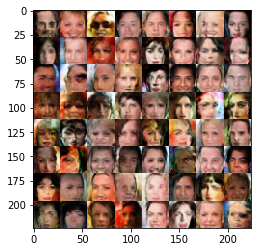

Epoch 1/1... Discriminator Loss: 1.3646... Generator Loss: 0.6868
Epoch 1/1... Discriminator Loss: 1.1324... Generator Loss: 0.9926
Epoch 1/1... Discriminator Loss: 1.1588... Generator Loss: 0.9084
Epoch 1/1... Discriminator Loss: 1.0234... Generator Loss: 1.0582
Epoch 1/1... Discriminator Loss: 1.2579... Generator Loss: 0.7280
Epoch 1/1... Discriminator Loss: 1.0725... Generator Loss: 0.7726
Epoch 1/1... Discriminator Loss: 0.8305... Generator Loss: 0.9209
Epoch 1/1... Discriminator Loss: 1.2731... Generator Loss: 0.5115
Epoch 1/1... Discriminator Loss: 0.8586... Generator Loss: 1.0474
Epoch 1/1... Discriminator Loss: 1.1683... Generator Loss: 0.8039


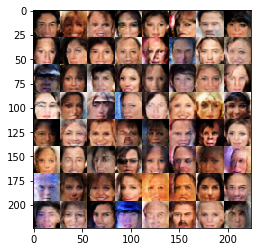

Epoch 1/1... Discriminator Loss: 1.1673... Generator Loss: 0.7206
Epoch 1/1... Discriminator Loss: 1.1717... Generator Loss: 0.5777
Epoch 1/1... Discriminator Loss: 1.1017... Generator Loss: 0.8264
Epoch 1/1... Discriminator Loss: 1.3186... Generator Loss: 0.5722
Epoch 1/1... Discriminator Loss: 1.2352... Generator Loss: 0.7438
Epoch 1/1... Discriminator Loss: 1.1570... Generator Loss: 0.8665
Epoch 1/1... Discriminator Loss: 1.2010... Generator Loss: 0.8707
Epoch 1/1... Discriminator Loss: 1.1501... Generator Loss: 0.7557
Epoch 1/1... Discriminator Loss: 1.3240... Generator Loss: 0.4650
Epoch 1/1... Discriminator Loss: 1.1943... Generator Loss: 0.8156


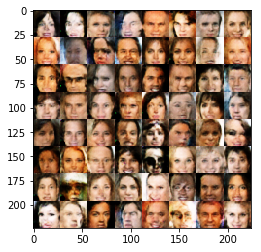

Epoch 1/1... Discriminator Loss: 0.9919... Generator Loss: 1.1107
Epoch 1/1... Discriminator Loss: 1.3597... Generator Loss: 0.5845
Epoch 1/1... Discriminator Loss: 1.0984... Generator Loss: 0.9096
Epoch 1/1... Discriminator Loss: 1.8358... Generator Loss: 0.3348
Epoch 1/1... Discriminator Loss: 1.6903... Generator Loss: 0.3510
Epoch 1/1... Discriminator Loss: 1.0448... Generator Loss: 1.1141
Epoch 1/1... Discriminator Loss: 1.2632... Generator Loss: 0.5687
Epoch 1/1... Discriminator Loss: 1.2100... Generator Loss: 0.8163
Epoch 1/1... Discriminator Loss: 1.2360... Generator Loss: 0.8283
Epoch 1/1... Discriminator Loss: 1.3493... Generator Loss: 0.5878


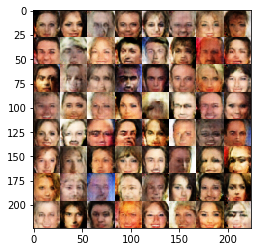

Epoch 1/1... Discriminator Loss: 1.2923... Generator Loss: 0.8777
Epoch 1/1... Discriminator Loss: 1.0913... Generator Loss: 1.0005
Epoch 1/1... Discriminator Loss: 1.1874... Generator Loss: 0.7341
Epoch 1/1... Discriminator Loss: 1.1683... Generator Loss: 0.6078
Epoch 1/1... Discriminator Loss: 1.1798... Generator Loss: 0.8830
Epoch 1/1... Discriminator Loss: 1.1280... Generator Loss: 1.0189
Epoch 1/1... Discriminator Loss: 1.0456... Generator Loss: 0.7798
Epoch 1/1... Discriminator Loss: 0.8996... Generator Loss: 0.9780
Epoch 1/1... Discriminator Loss: 0.8929... Generator Loss: 0.9175
Epoch 1/1... Discriminator Loss: 1.0917... Generator Loss: 1.0438


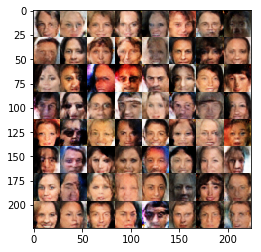

Epoch 1/1... Discriminator Loss: 1.0783... Generator Loss: 0.7568
Epoch 1/1... Discriminator Loss: 0.9705... Generator Loss: 0.9995
Epoch 1/1... Discriminator Loss: 1.1076... Generator Loss: 0.6616
Epoch 1/1... Discriminator Loss: 1.1009... Generator Loss: 0.8968
Epoch 1/1... Discriminator Loss: 1.0947... Generator Loss: 0.6879
Epoch 1/1... Discriminator Loss: 1.3774... Generator Loss: 0.3815
Epoch 1/1... Discriminator Loss: 1.0320... Generator Loss: 0.9040
Epoch 1/1... Discriminator Loss: 1.1706... Generator Loss: 0.7490
Epoch 1/1... Discriminator Loss: 1.3378... Generator Loss: 0.5532
Epoch 1/1... Discriminator Loss: 1.1904... Generator Loss: 0.7173


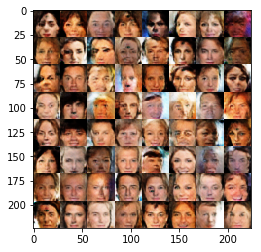

Epoch 1/1... Discriminator Loss: 1.1332... Generator Loss: 0.6137
Epoch 1/1... Discriminator Loss: 1.0637... Generator Loss: 1.0774
Epoch 1/1... Discriminator Loss: 1.0876... Generator Loss: 0.7567
Epoch 1/1... Discriminator Loss: 1.0535... Generator Loss: 0.9163
Epoch 1/1... Discriminator Loss: 1.0530... Generator Loss: 0.7942
Epoch 1/1... Discriminator Loss: 1.2681... Generator Loss: 0.5876
Epoch 1/1... Discriminator Loss: 1.0332... Generator Loss: 0.8088
Epoch 1/1... Discriminator Loss: 1.2248... Generator Loss: 0.7078
Epoch 1/1... Discriminator Loss: 1.1738... Generator Loss: 0.7633
Epoch 1/1... Discriminator Loss: 1.1734... Generator Loss: 0.7601


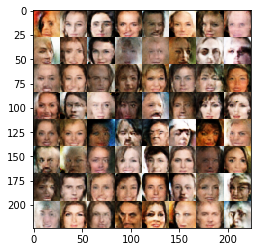

Epoch 1/1... Discriminator Loss: 1.0609... Generator Loss: 0.8881
Epoch 1/1... Discriminator Loss: 1.2207... Generator Loss: 0.7563
Epoch 1/1... Discriminator Loss: 1.1340... Generator Loss: 0.8694
Epoch 1/1... Discriminator Loss: 1.0910... Generator Loss: 0.7403
Epoch 1/1... Discriminator Loss: 1.1968... Generator Loss: 0.6106
Epoch 1/1... Discriminator Loss: 1.0884... Generator Loss: 0.8353
Epoch 1/1... Discriminator Loss: 1.3566... Generator Loss: 0.4676
Epoch 1/1... Discriminator Loss: 1.0049... Generator Loss: 0.9622
Epoch 1/1... Discriminator Loss: 0.9198... Generator Loss: 1.0094
Epoch 1/1... Discriminator Loss: 1.4690... Generator Loss: 0.6330


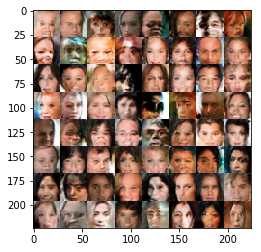

Epoch 1/1... Discriminator Loss: 1.0476... Generator Loss: 1.0095
Epoch 1/1... Discriminator Loss: 1.0198... Generator Loss: 0.8595
Epoch 1/1... Discriminator Loss: 1.2394... Generator Loss: 0.7277
Epoch 1/1... Discriminator Loss: 1.1155... Generator Loss: 0.8452
Epoch 1/1... Discriminator Loss: 1.5387... Generator Loss: 0.6862
Epoch 1/1... Discriminator Loss: 1.2432... Generator Loss: 0.6637
Epoch 1/1... Discriminator Loss: 1.2187... Generator Loss: 0.6650
Epoch 1/1... Discriminator Loss: 1.2069... Generator Loss: 0.6839
Epoch 1/1... Discriminator Loss: 1.3864... Generator Loss: 0.6261
Epoch 1/1... Discriminator Loss: 1.3136... Generator Loss: 0.6193


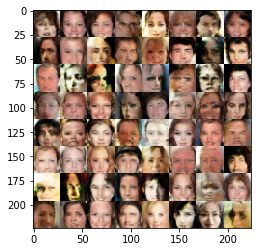

Epoch 1/1... Discriminator Loss: 1.1595... Generator Loss: 0.7514
Epoch 1/1... Discriminator Loss: 1.0318... Generator Loss: 0.8087
Epoch 1/1... Discriminator Loss: 1.1647... Generator Loss: 0.8695
Epoch 1/1... Discriminator Loss: 1.4943... Generator Loss: 0.6288
Epoch 1/1... Discriminator Loss: 1.5002... Generator Loss: 0.6150
Epoch 1/1... Discriminator Loss: 0.9971... Generator Loss: 0.9318
Epoch 1/1... Discriminator Loss: 1.3180... Generator Loss: 0.6956
Epoch 1/1... Discriminator Loss: 1.3270... Generator Loss: 0.6657
Epoch 1/1... Discriminator Loss: 1.1960... Generator Loss: 0.6600
Epoch 1/1... Discriminator Loss: 1.1031... Generator Loss: 1.0242


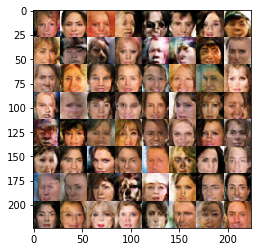

Epoch 1/1... Discriminator Loss: 1.6274... Generator Loss: 0.5321
Epoch 1/1... Discriminator Loss: 1.1730... Generator Loss: 0.8275
Epoch 1/1... Discriminator Loss: 1.0739... Generator Loss: 0.7382
Epoch 1/1... Discriminator Loss: 1.2881... Generator Loss: 0.7683
Epoch 1/1... Discriminator Loss: 1.0964... Generator Loss: 1.1660
Epoch 1/1... Discriminator Loss: 1.2709... Generator Loss: 0.8700
Epoch 1/1... Discriminator Loss: 1.0211... Generator Loss: 0.8987
Epoch 1/1... Discriminator Loss: 1.1374... Generator Loss: 0.7326
Epoch 1/1... Discriminator Loss: 1.0125... Generator Loss: 0.9920
Epoch 1/1... Discriminator Loss: 1.0797... Generator Loss: 0.8230


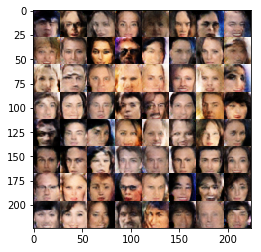

Epoch 1/1... Discriminator Loss: 0.9173... Generator Loss: 1.1409
Epoch 1/1... Discriminator Loss: 1.2051... Generator Loss: 0.8113
Epoch 1/1... Discriminator Loss: 1.1119... Generator Loss: 0.9933
Epoch 1/1... Discriminator Loss: 0.9094... Generator Loss: 0.9590
Epoch 1/1... Discriminator Loss: 1.1752... Generator Loss: 0.6099
Epoch 1/1... Discriminator Loss: 1.2089... Generator Loss: 0.9470
Epoch 1/1... Discriminator Loss: 1.0542... Generator Loss: 0.8335
Epoch 1/1... Discriminator Loss: 1.1210... Generator Loss: 1.0007
Epoch 1/1... Discriminator Loss: 1.3313... Generator Loss: 0.6574
Epoch 1/1... Discriminator Loss: 1.0462... Generator Loss: 1.1151


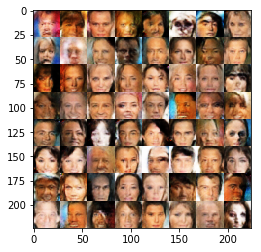

Epoch 1/1... Discriminator Loss: 1.3542... Generator Loss: 0.9113
Epoch 1/1... Discriminator Loss: 1.2098... Generator Loss: 0.7109
Epoch 1/1... Discriminator Loss: 1.2022... Generator Loss: 0.9708
Epoch 1/1... Discriminator Loss: 1.2277... Generator Loss: 0.8177
Epoch 1/1... Discriminator Loss: 1.2266... Generator Loss: 0.6652
Epoch 1/1... Discriminator Loss: 1.1734... Generator Loss: 0.7297
Epoch 1/1... Discriminator Loss: 1.2281... Generator Loss: 0.6080
Epoch 1/1... Discriminator Loss: 0.8938... Generator Loss: 1.0139
Epoch 1/1... Discriminator Loss: 1.2710... Generator Loss: 0.7094
Epoch 1/1... Discriminator Loss: 1.2263... Generator Loss: 0.7724


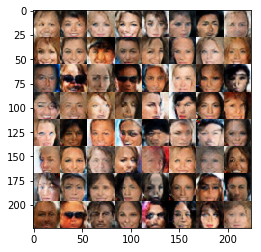

Epoch 1/1... Discriminator Loss: 1.1292... Generator Loss: 0.9585
Epoch 1/1... Discriminator Loss: 1.3713... Generator Loss: 0.5214
Epoch 1/1... Discriminator Loss: 1.3684... Generator Loss: 0.6469
Epoch 1/1... Discriminator Loss: 1.2150... Generator Loss: 0.5918
Epoch 1/1... Discriminator Loss: 0.8291... Generator Loss: 1.1677
Epoch 1/1... Discriminator Loss: 1.0418... Generator Loss: 0.9548
Epoch 1/1... Discriminator Loss: 1.1711... Generator Loss: 0.8354
Epoch 1/1... Discriminator Loss: 0.9446... Generator Loss: 1.0925
Epoch 1/1... Discriminator Loss: 1.3151... Generator Loss: 0.6050
Epoch 1/1... Discriminator Loss: 1.0334... Generator Loss: 0.8776


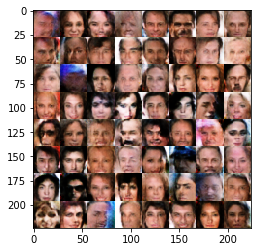

Epoch 1/1... Discriminator Loss: 1.1756... Generator Loss: 0.9060
Epoch 1/1... Discriminator Loss: 1.2487... Generator Loss: 0.8029
Epoch 1/1... Discriminator Loss: 1.1557... Generator Loss: 0.6421
Epoch 1/1... Discriminator Loss: 1.3052... Generator Loss: 0.6999
Epoch 1/1... Discriminator Loss: 1.0057... Generator Loss: 0.9569
Epoch 1/1... Discriminator Loss: 1.2621... Generator Loss: 0.6685
Epoch 1/1... Discriminator Loss: 1.1728... Generator Loss: 0.7427
Epoch 1/1... Discriminator Loss: 1.2336... Generator Loss: 0.7231
Epoch 1/1... Discriminator Loss: 1.2894... Generator Loss: 0.6626
Epoch 1/1... Discriminator Loss: 1.0420... Generator Loss: 0.8498


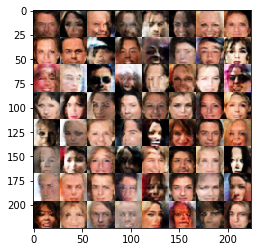

Epoch 1/1... Discriminator Loss: 1.4504... Generator Loss: 0.5652
Epoch 1/1... Discriminator Loss: 1.5104... Generator Loss: 0.4954
Epoch 1/1... Discriminator Loss: 1.1777... Generator Loss: 0.9813
Epoch 1/1... Discriminator Loss: 1.2080... Generator Loss: 0.8196
Epoch 1/1... Discriminator Loss: 1.2683... Generator Loss: 0.7645
Epoch 1/1... Discriminator Loss: 1.1656... Generator Loss: 0.7291
Epoch 1/1... Discriminator Loss: 1.1641... Generator Loss: 1.1205
Epoch 1/1... Discriminator Loss: 0.9659... Generator Loss: 0.7654
Epoch 1/1... Discriminator Loss: 1.2890... Generator Loss: 0.5653
Epoch 1/1... Discriminator Loss: 1.2176... Generator Loss: 0.6980


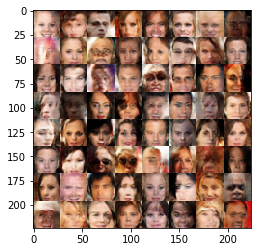

Epoch 1/1... Discriminator Loss: 0.8727... Generator Loss: 0.9934
Epoch 1/1... Discriminator Loss: 1.2122... Generator Loss: 0.7730
Epoch 1/1... Discriminator Loss: 1.3217... Generator Loss: 0.5827
Epoch 1/1... Discriminator Loss: 1.0497... Generator Loss: 0.7450
Epoch 1/1... Discriminator Loss: 1.1148... Generator Loss: 0.7814
Epoch 1/1... Discriminator Loss: 1.2004... Generator Loss: 0.6494
Epoch 1/1... Discriminator Loss: 1.2455... Generator Loss: 0.6778
Epoch 1/1... Discriminator Loss: 1.0375... Generator Loss: 0.8038
Epoch 1/1... Discriminator Loss: 1.3402... Generator Loss: 0.9392
Epoch 1/1... Discriminator Loss: 1.2237... Generator Loss: 0.7548


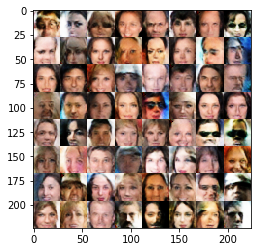

Epoch 1/1... Discriminator Loss: 1.0394... Generator Loss: 1.3569
Epoch 1/1... Discriminator Loss: 1.3125... Generator Loss: 0.6490
Epoch 1/1... Discriminator Loss: 1.0942... Generator Loss: 0.7814
Epoch 1/1... Discriminator Loss: 1.1272... Generator Loss: 0.7367
Epoch 1/1... Discriminator Loss: 0.9168... Generator Loss: 1.3363
Epoch 1/1... Discriminator Loss: 0.8843... Generator Loss: 1.0701
Epoch 1/1... Discriminator Loss: 1.3260... Generator Loss: 0.7430
Epoch 1/1... Discriminator Loss: 1.1952... Generator Loss: 1.0150
Epoch 1/1... Discriminator Loss: 1.1770... Generator Loss: 0.6065
Epoch 1/1... Discriminator Loss: 1.2761... Generator Loss: 0.6598


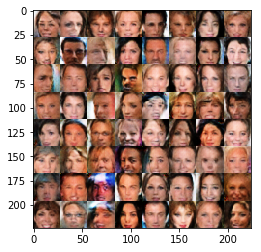

Epoch 1/1... Discriminator Loss: 1.2095... Generator Loss: 0.8163
Epoch 1/1... Discriminator Loss: 1.0273... Generator Loss: 0.8613
Epoch 1/1... Discriminator Loss: 1.2296... Generator Loss: 0.8042
Epoch 1/1... Discriminator Loss: 1.1436... Generator Loss: 0.8873
Epoch 1/1... Discriminator Loss: 1.1863... Generator Loss: 0.8226
Epoch 1/1... Discriminator Loss: 0.9834... Generator Loss: 1.0397
Epoch 1/1... Discriminator Loss: 1.3024... Generator Loss: 0.6874
Epoch 1/1... Discriminator Loss: 0.9733... Generator Loss: 0.9141
Epoch 1/1... Discriminator Loss: 1.0631... Generator Loss: 0.9368
Epoch 1/1... Discriminator Loss: 1.2950... Generator Loss: 0.8141


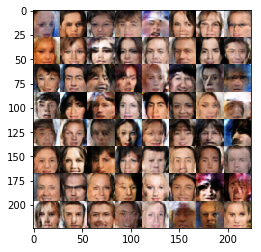

Epoch 1/1... Discriminator Loss: 1.1475... Generator Loss: 0.8029
Epoch 1/1... Discriminator Loss: 1.1229... Generator Loss: 0.9130
Epoch 1/1... Discriminator Loss: 1.1654... Generator Loss: 0.7246
Epoch 1/1... Discriminator Loss: 1.1870... Generator Loss: 0.7996
Epoch 1/1... Discriminator Loss: 1.2833... Generator Loss: 0.8459
Epoch 1/1... Discriminator Loss: 1.0798... Generator Loss: 0.7715
Epoch 1/1... Discriminator Loss: 1.1601... Generator Loss: 0.5974
Epoch 1/1... Discriminator Loss: 1.2078... Generator Loss: 0.6198
Epoch 1/1... Discriminator Loss: 1.2195... Generator Loss: 0.6513
Epoch 1/1... Discriminator Loss: 1.4102... Generator Loss: 0.4667


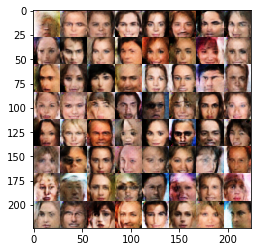

Epoch 1/1... Discriminator Loss: 1.2761... Generator Loss: 0.7173
Epoch 1/1... Discriminator Loss: 1.1570... Generator Loss: 0.6978
Epoch 1/1... Discriminator Loss: 1.1366... Generator Loss: 0.8294
Epoch 1/1... Discriminator Loss: 1.1045... Generator Loss: 0.8234
Epoch 1/1... Discriminator Loss: 1.3280... Generator Loss: 0.7035
Epoch 1/1... Discriminator Loss: 1.0103... Generator Loss: 0.8778
Epoch 1/1... Discriminator Loss: 1.2596... Generator Loss: 0.8624
Epoch 1/1... Discriminator Loss: 1.2302... Generator Loss: 0.6423
Epoch 1/1... Discriminator Loss: 1.1244... Generator Loss: 0.8276
Epoch 1/1... Discriminator Loss: 1.1745... Generator Loss: 0.8547


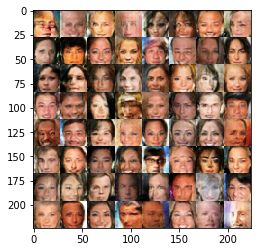

Epoch 1/1... Discriminator Loss: 1.3191... Generator Loss: 0.7667
Epoch 1/1... Discriminator Loss: 1.2407... Generator Loss: 0.6799
Epoch 1/1... Discriminator Loss: 0.9474... Generator Loss: 0.9485
Epoch 1/1... Discriminator Loss: 1.2359... Generator Loss: 0.6373
Epoch 1/1... Discriminator Loss: 1.2771... Generator Loss: 1.1353
Epoch 1/1... Discriminator Loss: 1.3626... Generator Loss: 0.5340
Epoch 1/1... Discriminator Loss: 1.3247... Generator Loss: 0.7743
Epoch 1/1... Discriminator Loss: 1.1805... Generator Loss: 0.7983
Epoch 1/1... Discriminator Loss: 1.1728... Generator Loss: 0.7259
Epoch 1/1... Discriminator Loss: 1.1598... Generator Loss: 1.3352


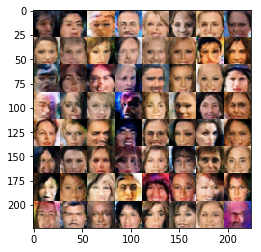

Epoch 1/1... Discriminator Loss: 1.1231... Generator Loss: 0.7866
Epoch 1/1... Discriminator Loss: 1.1959... Generator Loss: 0.7984
Epoch 1/1... Discriminator Loss: 1.2416... Generator Loss: 0.7371
Epoch 1/1... Discriminator Loss: 1.2244... Generator Loss: 0.7275
Epoch 1/1... Discriminator Loss: 1.1716... Generator Loss: 0.6359
Epoch 1/1... Discriminator Loss: 1.1386... Generator Loss: 0.8140
Epoch 1/1... Discriminator Loss: 1.5646... Generator Loss: 0.7067
Epoch 1/1... Discriminator Loss: 1.0762... Generator Loss: 0.8220
Epoch 1/1... Discriminator Loss: 1.1912... Generator Loss: 0.7148
Epoch 1/1... Discriminator Loss: 1.1761... Generator Loss: 0.9681


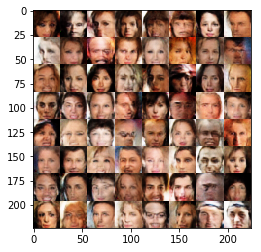

Epoch 1/1... Discriminator Loss: 1.1552... Generator Loss: 0.7957
Epoch 1/1... Discriminator Loss: 1.2637... Generator Loss: 0.6431
Epoch 1/1... Discriminator Loss: 1.1232... Generator Loss: 0.8221
Epoch 1/1... Discriminator Loss: 1.0020... Generator Loss: 0.9459
Epoch 1/1... Discriminator Loss: 1.0463... Generator Loss: 0.7655
Epoch 1/1... Discriminator Loss: 1.3302... Generator Loss: 0.9423
Epoch 1/1... Discriminator Loss: 1.1397... Generator Loss: 0.8800
Epoch 1/1... Discriminator Loss: 1.2888... Generator Loss: 0.5489
Epoch 1/1... Discriminator Loss: 1.1199... Generator Loss: 0.7960
Epoch 1/1... Discriminator Loss: 1.0443... Generator Loss: 0.8447


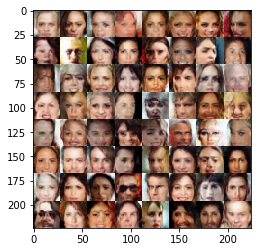

Epoch 1/1... Discriminator Loss: 1.3460... Generator Loss: 0.6393
Epoch 1/1... Discriminator Loss: 1.1379... Generator Loss: 1.0561
Epoch 1/1... Discriminator Loss: 1.3094... Generator Loss: 0.7996
Epoch 1/1... Discriminator Loss: 0.9990... Generator Loss: 0.9391
Epoch 1/1... Discriminator Loss: 1.2978... Generator Loss: 0.5539
Epoch 1/1... Discriminator Loss: 1.3761... Generator Loss: 0.5777
Epoch 1/1... Discriminator Loss: 1.1345... Generator Loss: 0.7124
Epoch 1/1... Discriminator Loss: 1.2750... Generator Loss: 0.6467
Epoch 1/1... Discriminator Loss: 1.1247... Generator Loss: 0.8577
Epoch 1/1... Discriminator Loss: 1.2331... Generator Loss: 0.7334


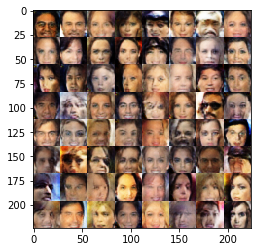

Epoch 1/1... Discriminator Loss: 1.0542... Generator Loss: 0.8566
Epoch 1/1... Discriminator Loss: 1.1247... Generator Loss: 0.7333
Epoch 1/1... Discriminator Loss: 1.0081... Generator Loss: 0.8286
Epoch 1/1... Discriminator Loss: 1.1716... Generator Loss: 0.6384
Epoch 1/1... Discriminator Loss: 1.2202... Generator Loss: 0.7510
Epoch 1/1... Discriminator Loss: 0.9813... Generator Loss: 0.9671
Epoch 1/1... Discriminator Loss: 1.3453... Generator Loss: 0.7854
Epoch 1/1... Discriminator Loss: 1.2216... Generator Loss: 0.6619
Epoch 1/1... Discriminator Loss: 1.0410... Generator Loss: 0.8641
Epoch 1/1... Discriminator Loss: 1.0534... Generator Loss: 0.9356


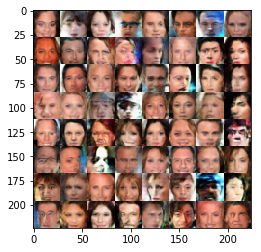

Epoch 1/1... Discriminator Loss: 1.0316... Generator Loss: 0.8184
Epoch 1/1... Discriminator Loss: 1.2215... Generator Loss: 0.7506
Epoch 1/1... Discriminator Loss: 0.9828... Generator Loss: 0.8523
Epoch 1/1... Discriminator Loss: 1.0879... Generator Loss: 0.7996
Epoch 1/1... Discriminator Loss: 0.9332... Generator Loss: 1.1650
Epoch 1/1... Discriminator Loss: 1.5280... Generator Loss: 0.6905
Epoch 1/1... Discriminator Loss: 1.2123... Generator Loss: 0.7247
Epoch 1/1... Discriminator Loss: 1.0176... Generator Loss: 1.2664
Epoch 1/1... Discriminator Loss: 1.4334... Generator Loss: 0.8068
Epoch 1/1... Discriminator Loss: 1.0416... Generator Loss: 1.0945


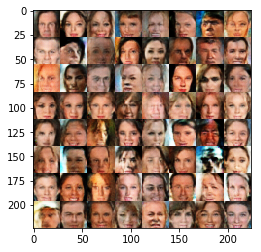

Epoch 1/1... Discriminator Loss: 1.2634... Generator Loss: 0.6932
Epoch 1/1... Discriminator Loss: 1.0154... Generator Loss: 0.8835
Epoch 1/1... Discriminator Loss: 1.2123... Generator Loss: 0.6823
Epoch 1/1... Discriminator Loss: 1.0989... Generator Loss: 0.9414
Epoch 1/1... Discriminator Loss: 1.2217... Generator Loss: 0.7528
Epoch 1/1... Discriminator Loss: 1.0461... Generator Loss: 0.7862
Epoch 1/1... Discriminator Loss: 1.2166... Generator Loss: 0.7189
Epoch 1/1... Discriminator Loss: 1.0380... Generator Loss: 0.7982
Epoch 1/1... Discriminator Loss: 1.1951... Generator Loss: 0.8085
Epoch 1/1... Discriminator Loss: 1.3032... Generator Loss: 0.8590


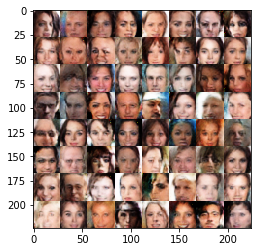

Epoch 1/1... Discriminator Loss: 1.1306... Generator Loss: 0.7902
Epoch 1/1... Discriminator Loss: 1.3334... Generator Loss: 0.6869
Epoch 1/1... Discriminator Loss: 1.0684... Generator Loss: 0.6250
Epoch 1/1... Discriminator Loss: 1.0719... Generator Loss: 1.1456
Epoch 1/1... Discriminator Loss: 1.2488... Generator Loss: 0.7746
Epoch 1/1... Discriminator Loss: 1.3310... Generator Loss: 0.7061
Epoch 1/1... Discriminator Loss: 1.1632... Generator Loss: 0.6878
Epoch 1/1... Discriminator Loss: 0.9768... Generator Loss: 1.0019
Epoch 1/1... Discriminator Loss: 1.3524... Generator Loss: 0.7402
Epoch 1/1... Discriminator Loss: 1.2709... Generator Loss: 0.6868


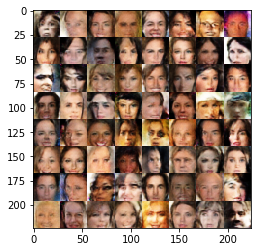

Epoch 1/1... Discriminator Loss: 1.2366... Generator Loss: 0.6433
Epoch 1/1... Discriminator Loss: 1.0845... Generator Loss: 0.8106
Epoch 1/1... Discriminator Loss: 1.3289... Generator Loss: 0.5982
Epoch 1/1... Discriminator Loss: 1.0011... Generator Loss: 0.8495
Epoch 1/1... Discriminator Loss: 1.2141... Generator Loss: 0.9313
Epoch 1/1... Discriminator Loss: 1.2786... Generator Loss: 0.7569
Epoch 1/1... Discriminator Loss: 1.1589... Generator Loss: 0.9395
Epoch 1/1... Discriminator Loss: 1.1455... Generator Loss: 0.7960
Epoch 1/1... Discriminator Loss: 1.1514... Generator Loss: 0.8049
Epoch 1/1... Discriminator Loss: 1.2128... Generator Loss: 0.6909


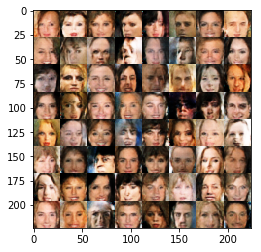

Epoch 1/1... Discriminator Loss: 1.0738... Generator Loss: 0.9381
Epoch 1/1... Discriminator Loss: 1.1963... Generator Loss: 0.6623
Epoch 1/1... Discriminator Loss: 1.1322... Generator Loss: 0.9004
Epoch 1/1... Discriminator Loss: 1.2517... Generator Loss: 0.5373
Epoch 1/1... Discriminator Loss: 1.1522... Generator Loss: 0.6951
Epoch 1/1... Discriminator Loss: 1.0927... Generator Loss: 0.7237
Epoch 1/1... Discriminator Loss: 1.2520... Generator Loss: 0.6649
Epoch 1/1... Discriminator Loss: 1.3173... Generator Loss: 0.6844
Epoch 1/1... Discriminator Loss: 1.0428... Generator Loss: 0.7694
Epoch 1/1... Discriminator Loss: 1.0170... Generator Loss: 0.7636


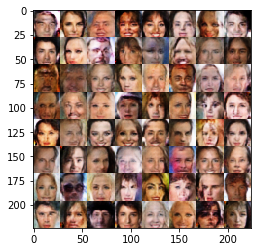

Epoch 1/1... Discriminator Loss: 0.9489... Generator Loss: 0.8872
Epoch 1/1... Discriminator Loss: 1.2394... Generator Loss: 0.6573
Epoch 1/1... Discriminator Loss: 1.2480... Generator Loss: 0.7316
Epoch 1/1... Discriminator Loss: 1.2118... Generator Loss: 0.6591
Epoch 1/1... Discriminator Loss: 1.1606... Generator Loss: 0.7187
Epoch 1/1... Discriminator Loss: 1.2818... Generator Loss: 0.6278
Epoch 1/1... Discriminator Loss: 1.1480... Generator Loss: 0.9455
Epoch 1/1... Discriminator Loss: 1.1353... Generator Loss: 0.9064
Epoch 1/1... Discriminator Loss: 1.3355... Generator Loss: 0.6946
Epoch 1/1... Discriminator Loss: 1.0354... Generator Loss: 0.8839


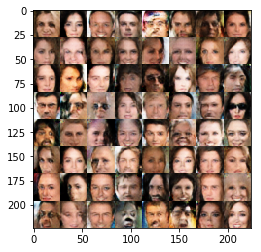

Epoch 1/1... Discriminator Loss: 1.3026... Generator Loss: 0.8045
Epoch 1/1... Discriminator Loss: 1.1480... Generator Loss: 0.7175
Epoch 1/1... Discriminator Loss: 1.2069... Generator Loss: 0.8117
Epoch 1/1... Discriminator Loss: 1.1963... Generator Loss: 0.6606
Epoch 1/1... Discriminator Loss: 1.2825... Generator Loss: 0.5857
Epoch 1/1... Discriminator Loss: 1.2017... Generator Loss: 0.6752
Epoch 1/1... Discriminator Loss: 1.1799... Generator Loss: 0.7572
Epoch 1/1... Discriminator Loss: 1.1955... Generator Loss: 0.8430
Epoch 1/1... Discriminator Loss: 1.0353... Generator Loss: 0.7939
Epoch 1/1... Discriminator Loss: 1.2134... Generator Loss: 0.6961


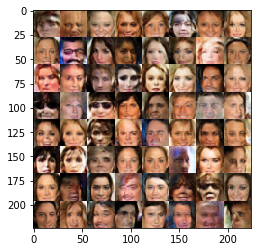

Epoch 1/1... Discriminator Loss: 1.0999... Generator Loss: 0.9005
Epoch 1/1... Discriminator Loss: 1.2893... Generator Loss: 0.6678
Epoch 1/1... Discriminator Loss: 1.1429... Generator Loss: 0.7187
Epoch 1/1... Discriminator Loss: 1.1220... Generator Loss: 0.7577
Epoch 1/1... Discriminator Loss: 1.2879... Generator Loss: 0.6519
Epoch 1/1... Discriminator Loss: 1.2148... Generator Loss: 0.7271
Epoch 1/1... Discriminator Loss: 1.1750... Generator Loss: 0.9356
Epoch 1/1... Discriminator Loss: 1.0839... Generator Loss: 0.8683
Epoch 1/1... Discriminator Loss: 1.2173... Generator Loss: 0.7470
Epoch 1/1... Discriminator Loss: 1.4260... Generator Loss: 1.0759


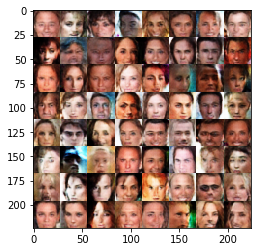

Epoch 1/1... Discriminator Loss: 1.1706... Generator Loss: 0.8586
Epoch 1/1... Discriminator Loss: 1.0297... Generator Loss: 0.7925
Epoch 1/1... Discriminator Loss: 1.3030... Generator Loss: 0.6437
Epoch 1/1... Discriminator Loss: 1.3609... Generator Loss: 0.8125
Epoch 1/1... Discriminator Loss: 1.0883... Generator Loss: 0.6914
Epoch 1/1... Discriminator Loss: 1.1597... Generator Loss: 0.8716
Epoch 1/1... Discriminator Loss: 1.6669... Generator Loss: 1.0382
Epoch 1/1... Discriminator Loss: 1.0041... Generator Loss: 0.8792
Epoch 1/1... Discriminator Loss: 1.1878... Generator Loss: 0.8369
Epoch 1/1... Discriminator Loss: 0.7949... Generator Loss: 1.1389


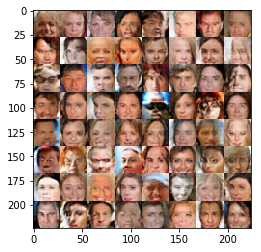

Epoch 1/1... Discriminator Loss: 1.1130... Generator Loss: 0.6614
Epoch 1/1... Discriminator Loss: 1.1479... Generator Loss: 0.6818
Epoch 1/1... Discriminator Loss: 1.3437... Generator Loss: 0.5579
Epoch 1/1... Discriminator Loss: 1.0078... Generator Loss: 1.0010
Epoch 1/1... Discriminator Loss: 1.4336... Generator Loss: 0.4864
Epoch 1/1... Discriminator Loss: 1.2132... Generator Loss: 1.0274
Epoch 1/1... Discriminator Loss: 1.2454... Generator Loss: 0.7436
Epoch 1/1... Discriminator Loss: 1.0503... Generator Loss: 0.7229
Epoch 1/1... Discriminator Loss: 1.3249... Generator Loss: 0.5438
Epoch 1/1... Discriminator Loss: 1.2550... Generator Loss: 0.5798


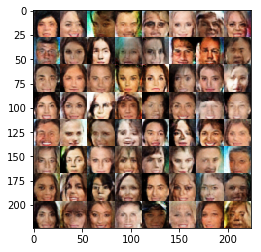

Epoch 1/1... Discriminator Loss: 1.0054... Generator Loss: 0.9382
Epoch 1/1... Discriminator Loss: 1.2173... Generator Loss: 0.9718
Epoch 1/1... Discriminator Loss: 1.2128... Generator Loss: 0.7127
Epoch 1/1... Discriminator Loss: 1.0642... Generator Loss: 0.8827
Epoch 1/1... Discriminator Loss: 1.2232... Generator Loss: 0.7813
Epoch 1/1... Discriminator Loss: 1.1580... Generator Loss: 0.8428
Epoch 1/1... Discriminator Loss: 1.3151... Generator Loss: 0.7035
Epoch 1/1... Discriminator Loss: 1.1330... Generator Loss: 0.8232
Epoch 1/1... Discriminator Loss: 1.2322... Generator Loss: 0.6402
Epoch 1/1... Discriminator Loss: 1.2388... Generator Loss: 0.6668


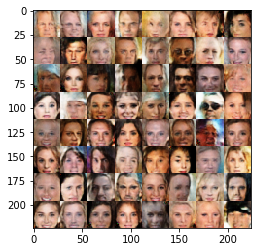

Epoch 1/1... Discriminator Loss: 1.3475... Generator Loss: 0.6986
Epoch 1/1... Discriminator Loss: 1.2253... Generator Loss: 0.8717
Epoch 1/1... Discriminator Loss: 1.1253... Generator Loss: 0.8673
Epoch 1/1... Discriminator Loss: 1.1621... Generator Loss: 0.8734
Epoch 1/1... Discriminator Loss: 1.2513... Generator Loss: 0.7470
Epoch 1/1... Discriminator Loss: 1.2783... Generator Loss: 0.6220
Epoch 1/1... Discriminator Loss: 1.0973... Generator Loss: 0.6974
Epoch 1/1... Discriminator Loss: 1.0433... Generator Loss: 0.8657
Epoch 1/1... Discriminator Loss: 1.3545... Generator Loss: 0.7048
Epoch 1/1... Discriminator Loss: 1.1687... Generator Loss: 0.8809


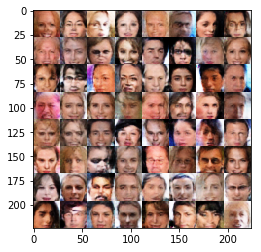

Epoch 1/1... Discriminator Loss: 1.2519... Generator Loss: 0.5970
Epoch 1/1... Discriminator Loss: 1.0597... Generator Loss: 0.8953
Epoch 1/1... Discriminator Loss: 1.1194... Generator Loss: 0.8222
Epoch 1/1... Discriminator Loss: 1.2257... Generator Loss: 0.6883
Epoch 1/1... Discriminator Loss: 1.2927... Generator Loss: 0.7839
Epoch 1/1... Discriminator Loss: 1.1634... Generator Loss: 0.8128
Epoch 1/1... Discriminator Loss: 1.2055... Generator Loss: 0.6377
Epoch 1/1... Discriminator Loss: 1.1828... Generator Loss: 0.6501
Epoch 1/1... Discriminator Loss: 1.2769... Generator Loss: 0.6319
Epoch 1/1... Discriminator Loss: 1.1314... Generator Loss: 0.9061


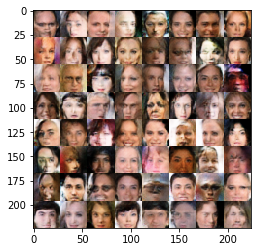

Epoch 1/1... Discriminator Loss: 1.3076... Generator Loss: 0.6618
Epoch 1/1... Discriminator Loss: 1.1351... Generator Loss: 0.7363
Epoch 1/1... Discriminator Loss: 1.1332... Generator Loss: 0.7502
Epoch 1/1... Discriminator Loss: 1.1676... Generator Loss: 0.7170
Epoch 1/1... Discriminator Loss: 1.1664... Generator Loss: 0.7712
Epoch 1/1... Discriminator Loss: 1.1176... Generator Loss: 1.0255
Epoch 1/1... Discriminator Loss: 1.2916... Generator Loss: 0.5953
Epoch 1/1... Discriminator Loss: 1.1476... Generator Loss: 0.6711
Epoch 1/1... Discriminator Loss: 1.1676... Generator Loss: 0.7188
Epoch 1/1... Discriminator Loss: 1.2135... Generator Loss: 0.6216


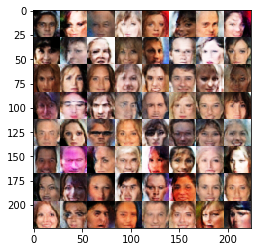

Epoch 1/1... Discriminator Loss: 1.1779... Generator Loss: 0.7248
Epoch 1/1... Discriminator Loss: 1.0928... Generator Loss: 0.8673
Epoch 1/1... Discriminator Loss: 1.2261... Generator Loss: 0.6645
Epoch 1/1... Discriminator Loss: 1.1504... Generator Loss: 0.6001
Epoch 1/1... Discriminator Loss: 1.1556... Generator Loss: 0.6421
Epoch 1/1... Discriminator Loss: 1.2239... Generator Loss: 0.6133
Epoch 1/1... Discriminator Loss: 1.0435... Generator Loss: 0.7649
Epoch 1/1... Discriminator Loss: 1.3400... Generator Loss: 0.7601
Epoch 1/1... Discriminator Loss: 1.1439... Generator Loss: 0.8939
Epoch 1/1... Discriminator Loss: 0.8417... Generator Loss: 0.9710


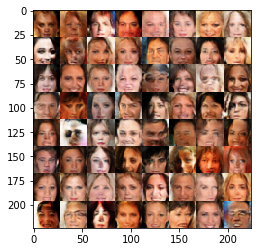

Epoch 1/1... Discriminator Loss: 1.1434... Generator Loss: 0.8612
Epoch 1/1... Discriminator Loss: 1.1965... Generator Loss: 0.6818
Epoch 1/1... Discriminator Loss: 1.2733... Generator Loss: 0.6930
Epoch 1/1... Discriminator Loss: 1.0007... Generator Loss: 0.8311
Epoch 1/1... Discriminator Loss: 1.1208... Generator Loss: 0.9060
Epoch 1/1... Discriminator Loss: 1.0890... Generator Loss: 0.7044
Epoch 1/1... Discriminator Loss: 1.4399... Generator Loss: 0.4561
Epoch 1/1... Discriminator Loss: 1.2377... Generator Loss: 0.6806
Epoch 1/1... Discriminator Loss: 1.0926... Generator Loss: 0.8189
Epoch 1/1... Discriminator Loss: 1.1812... Generator Loss: 0.7075


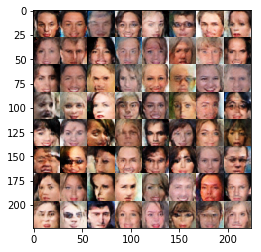

Epoch 1/1... Discriminator Loss: 1.2384... Generator Loss: 0.6539
Epoch 1/1... Discriminator Loss: 1.3247... Generator Loss: 0.6004
Epoch 1/1... Discriminator Loss: 1.1012... Generator Loss: 0.8306
Epoch 1/1... Discriminator Loss: 1.1734... Generator Loss: 0.7109
Epoch 1/1... Discriminator Loss: 0.9860... Generator Loss: 0.9899
Epoch 1/1... Discriminator Loss: 1.2513... Generator Loss: 0.8071
Epoch 1/1... Discriminator Loss: 1.2455... Generator Loss: 0.7571
Epoch 1/1... Discriminator Loss: 1.1257... Generator Loss: 0.7897
Epoch 1/1... Discriminator Loss: 1.3184... Generator Loss: 0.5752
Epoch 1/1... Discriminator Loss: 1.1281... Generator Loss: 0.7276


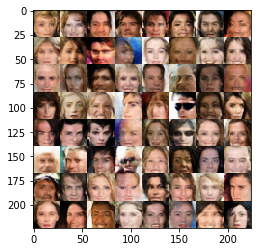

Epoch 1/1... Discriminator Loss: 1.0147... Generator Loss: 0.8846
Epoch 1/1... Discriminator Loss: 1.3328... Generator Loss: 0.5743
Epoch 1/1... Discriminator Loss: 1.2467... Generator Loss: 0.7029
Epoch 1/1... Discriminator Loss: 1.2696... Generator Loss: 0.6522
Epoch 1/1... Discriminator Loss: 1.3357... Generator Loss: 0.5995
Epoch 1/1... Discriminator Loss: 1.1412... Generator Loss: 0.9860
Epoch 1/1... Discriminator Loss: 1.1400... Generator Loss: 0.7418
Epoch 1/1... Discriminator Loss: 0.5998... Generator Loss: 1.1321
Epoch 1/1... Discriminator Loss: 1.0042... Generator Loss: 0.6737
Epoch 1/1... Discriminator Loss: 1.3050... Generator Loss: 0.5902


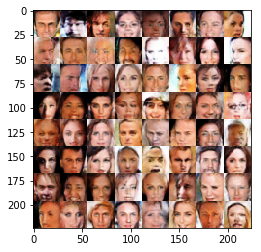

Epoch 1/1... Discriminator Loss: 1.2555... Generator Loss: 0.8883
Epoch 1/1... Discriminator Loss: 1.2076... Generator Loss: 0.7674
Epoch 1/1... Discriminator Loss: 1.2897... Generator Loss: 0.9631
Epoch 1/1... Discriminator Loss: 1.0932... Generator Loss: 0.8307
Epoch 1/1... Discriminator Loss: 1.1567... Generator Loss: 0.7937
Epoch 1/1... Discriminator Loss: 1.5969... Generator Loss: 0.4049
Epoch 1/1... Discriminator Loss: 1.1197... Generator Loss: 1.0794
Epoch 1/1... Discriminator Loss: 1.2678... Generator Loss: 0.6937
Epoch 1/1... Discriminator Loss: 1.1087... Generator Loss: 0.8265
Epoch 1/1... Discriminator Loss: 1.3415... Generator Loss: 0.5781


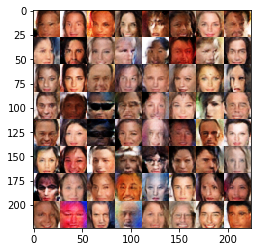

Epoch 1/1... Discriminator Loss: 1.3270... Generator Loss: 0.5894
Epoch 1/1... Discriminator Loss: 1.0037... Generator Loss: 0.8430
Epoch 1/1... Discriminator Loss: 1.1784... Generator Loss: 0.6977
Epoch 1/1... Discriminator Loss: 1.2230... Generator Loss: 0.7101
Epoch 1/1... Discriminator Loss: 1.2347... Generator Loss: 0.7740
Epoch 1/1... Discriminator Loss: 1.3137... Generator Loss: 0.7874
Epoch 1/1... Discriminator Loss: 1.1375... Generator Loss: 0.8331
Epoch 1/1... Discriminator Loss: 1.3254... Generator Loss: 0.7640
Epoch 1/1... Discriminator Loss: 1.3419... Generator Loss: 0.6401
Epoch 1/1... Discriminator Loss: 1.1298... Generator Loss: 0.8257


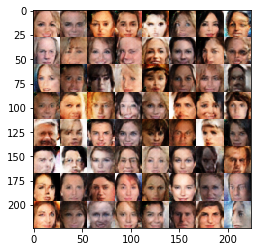

Epoch 1/1... Discriminator Loss: 1.1507... Generator Loss: 0.6639
Epoch 1/1... Discriminator Loss: 1.1167... Generator Loss: 0.7731
Epoch 1/1... Discriminator Loss: 1.2038... Generator Loss: 0.6696
Epoch 1/1... Discriminator Loss: 1.3042... Generator Loss: 0.5896
Epoch 1/1... Discriminator Loss: 1.0850... Generator Loss: 0.7702
Epoch 1/1... Discriminator Loss: 1.4353... Generator Loss: 0.5061
Epoch 1/1... Discriminator Loss: 1.2563... Generator Loss: 0.6079
Epoch 1/1... Discriminator Loss: 1.2950... Generator Loss: 0.6143
Epoch 1/1... Discriminator Loss: 1.1593... Generator Loss: 0.7323
Epoch 1/1... Discriminator Loss: 1.1759... Generator Loss: 0.5805


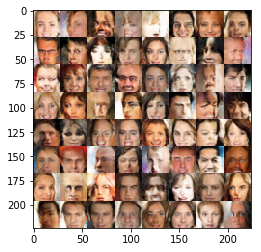

Epoch 1/1... Discriminator Loss: 1.1409... Generator Loss: 0.7553
Epoch 1/1... Discriminator Loss: 1.0122... Generator Loss: 0.7945
Epoch 1/1... Discriminator Loss: 1.2133... Generator Loss: 0.7572
Epoch 1/1... Discriminator Loss: 1.4229... Generator Loss: 0.5789
Epoch 1/1... Discriminator Loss: 1.2456... Generator Loss: 0.6526
Epoch 1/1... Discriminator Loss: 1.3300... Generator Loss: 0.7999
Epoch 1/1... Discriminator Loss: 1.0305... Generator Loss: 0.8437
Epoch 1/1... Discriminator Loss: 0.9833... Generator Loss: 0.8617
Epoch 1/1... Discriminator Loss: 1.3344... Generator Loss: 0.6322
Epoch 1/1... Discriminator Loss: 1.3498... Generator Loss: 0.5675


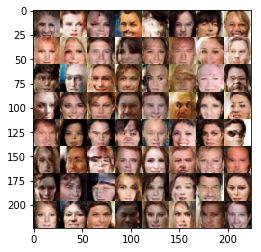

Epoch 1/1... Discriminator Loss: 1.1423... Generator Loss: 0.7380
Epoch 1/1... Discriminator Loss: 1.1556... Generator Loss: 0.6882
Epoch 1/1... Discriminator Loss: 1.1023... Generator Loss: 0.7527
Epoch 1/1... Discriminator Loss: 1.2614... Generator Loss: 0.7305
Epoch 1/1... Discriminator Loss: 1.2692... Generator Loss: 0.6849
Epoch 1/1... Discriminator Loss: 1.1818... Generator Loss: 0.6992


In [0]:
batch_size = 16
z_dim = 100
learning_rate = 0.0002
beta1 = 0.5

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 1

celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, celeba_dataset.get_batches,
          celeba_dataset.shape, celeba_dataset.image_mode)

### Submitting This Project
When submitting this project, make sure to run all the cells before saving the notebook. Save the notebook file as "dlnd_face_generation.ipynb" and save it as a HTML file under "File" -> "Download as". Include the "helper.py" and "problem_unittests.py" files in your submission.